In [2]:
%pip install timm shap grad-cam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 15.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 532.9/532.9 kB 22.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 50.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for grad-cam: filename=grad_cam-1.4.8-py3-none-any.whl size=38244 sha256=683468a9fdb7178f7da7f38068566e18e9ced37bf45511f5834e4fa52d087aa6
  Stored in directory: /root/.cache/pip/wheels/f8/04/36/94ff3c8a4215826a21946b34c01180817e606989fdf53f7cd6
Successfully built grad-cam


In [3]:
%pip install git+https://github.com/pytorch/captum.git

  Cloning https://github.com/pytorch/captum.git to /tmp/pip-req-build-v57w9g0f
  Running command git clone --filter=blob:none --quiet https://github.com/pytorch/captum.git /tmp/pip-req-build-v57w9g0f
  Resolved https://github.com/pytorch/captum.git to commit ed3b1fa4b3d8afc0eff4179b1d1ef4b191f13cc1
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for captum: filename=captum-0.6.0-py3-none-any.whl size=598774 sha256=2de31b01b750d67b5b5a2dea1d16e5fea0bb4dfab9164e2cb228a621be132a71
  Stored in directory: /tmp/pip-ephem-wheel-cache-w446mq90/wheels/8e/b7/c3/e17a61e561b99ab720ae04e56543dcd69884dee09a09bf5ae4
Successfully built captum


In [5]:
#contains pretrained timm model
import urllib
import os
# import gradio as gr
import torch
import timm
import numpy as np

from PIL import Image
from timm.data import resolve_data_config
from timm.data.transforms_factory import create_transform

import torchvision.transforms as T
import torch.nn.functional as F
from matplotlib.colors import LinearSegmentedColormap

from typing import Dict

from captum.attr import IntegratedGradients
from captum.attr import GradientShap
from captum.attr import Occlusion
from captum.attr import NoiseTunnel
from captum.attr import visualization as viz

from captum.attr import Saliency
from captum.attr import DeepLift

#imports specifically for gradcam:
import timm
import torch
import torchvision.transforms as T
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from pytorch_grad_cam import GradCAM, HiResCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM, FullGrad
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
from pytorch_grad_cam import GradCAMPlusPlus

In [6]:
device = torch.device("cuda:0")
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [6]:
MODEL: str = "resnet18"

model = timm.create_model(MODEL, pretrained=True)
model.eval()
url, filename = (
    "https://raw.githubusercontent.com/pytorch/hub/master/imagenet_classes.txt",
    "imagenet_classes.txt",
)
urllib.request.urlretrieve(url, filename)
with open("imagenet_classes.txt", "r") as f:
    categories = [s.strip() for s in f.readlines()]

transform = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor()
])

transform_normalize = T.Normalize(
     mean=[0.485, 0.456, 0.406],
     std=[0.229, 0.224, 0.225]
)

model.safetensors:   0%|          | 0.00/46.8M [00:00<?, ?B/s]

In [7]:
import shap

Processing image:  <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1000x1000 at 0x7E5878FAFD00>
Predicted: envelope ( 0.32102081179618835 )
the integrated gradients: 


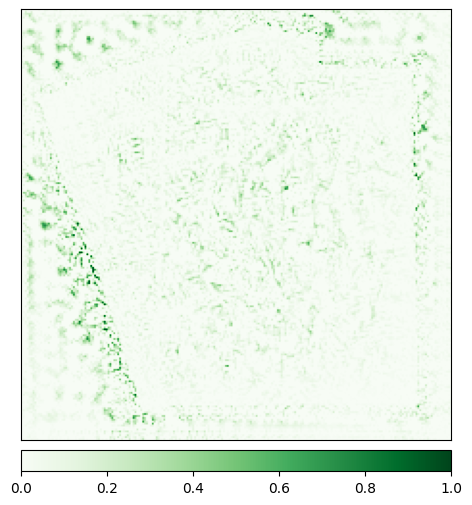

integrated gradients with noise tunnel


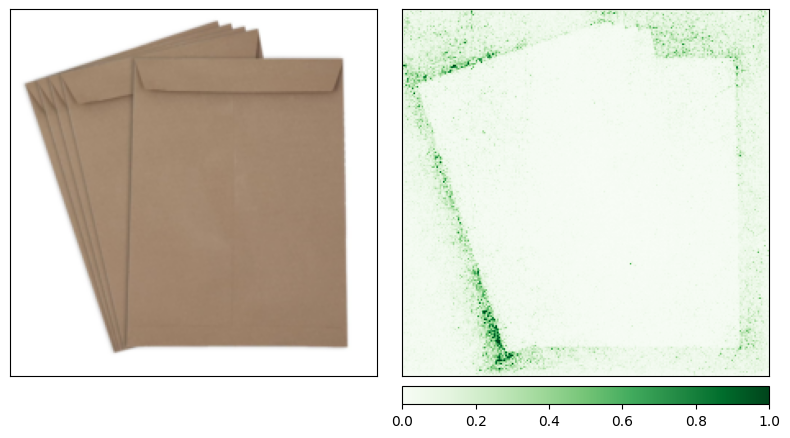

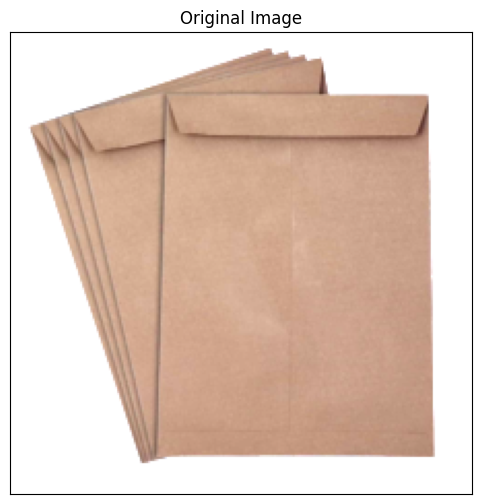

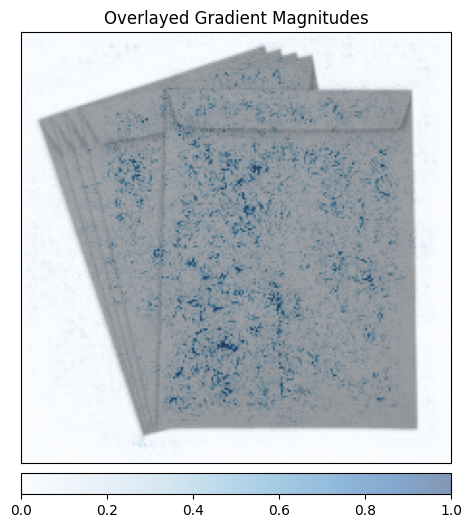

Occlusion Model Explainability: 


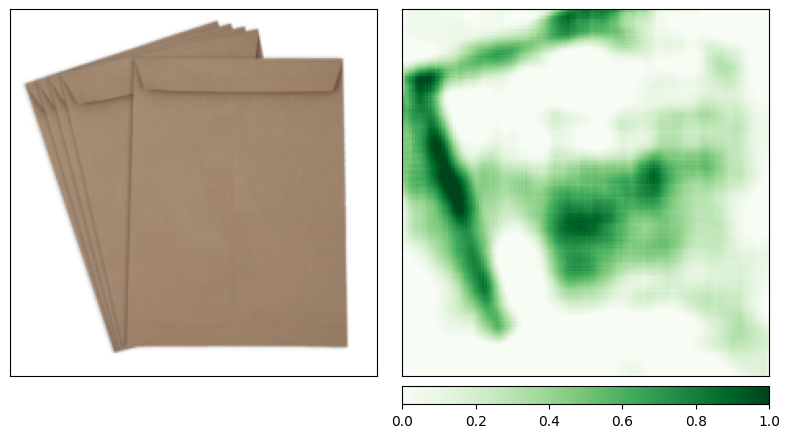

SHAP model explaiability: 


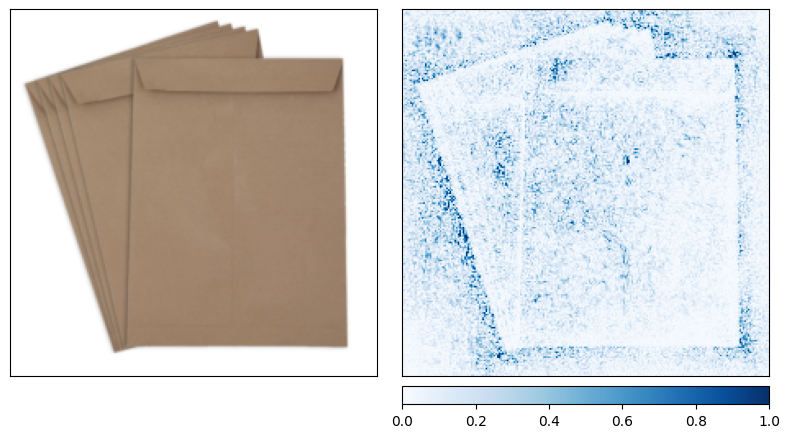

GRAD model explainability: 


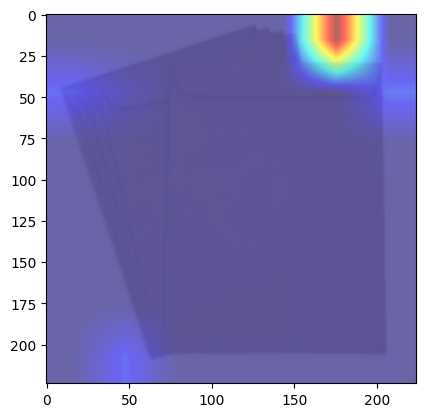

In [9]:
# images = os.listdir("/home/shilpi_fire/Music/dockerize/img_dir")
# for image in images:
    #create model then perform prediction
image  = Image.open('/content/9.jpg')
print("Processing image: ", image)
# img = Image.open('/home/shilpi_fire/Music/dockerize/img_dir/' + image)
transformed_img = transform(image)
img_tensor = transform_normalize(transformed_img)
img_tensor = img_tensor.unsqueeze(0)
img_tensor = img_tensor.to(device)

model = model.to(device)

with torch.no_grad():
    output = model(img_tensor)
output = F.softmax(output, dim=1)
prediction_score, pred_label_idx = torch.topk(output, 1)
pred_label_idx.squeeze_()
predicted_label = categories[pred_label_idx.item()]
print('Predicted:', predicted_label, '(', prediction_score.squeeze().item(), ')')

#code for IG
print('the integrated gradients: ')
integrated_gradients = IntegratedGradients(model)
default_cmap = LinearSegmentedColormap.from_list('custom blue',
                                              [(0, '#ffffff'),
                                              (1, '#000000')], N=256)
attributions_ig = integrated_gradients.attribute(img_tensor, target=285, n_steps=400)

_ = viz.visualize_image_attr(np.transpose(attributions_ig.squeeze().cpu().detach().numpy(), (1, 2, 0)),
                            np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1, 2, 0)),
                            method='heat_map',
                            #  cmap=default_cmap,
                            show_colorbar=True,
                            sign='positive',
                            outlier_perc=1)

#code for IG with Noise Tunnel
print('integrated gradients with noise tunnel')
noise_tunnel = NoiseTunnel(integrated_gradients)

attributions_ig_nt = noise_tunnel.attribute(img_tensor, nt_samples=10, nt_type='smoothgrad_sq', target=pred_label_idx)
_ = viz.visualize_image_attr_multiple(np.transpose(attributions_ig_nt.squeeze().cpu().detach().numpy(), (1, 2, 0)),
                                    np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1, 2, 0)),
                                    ["original_image", "heat_map"],
                                    ["all", "positive"],
                                    #   cmap=default_cmap,
                                    show_colorbar=True)
#code for saliency:
print('Saliency Model Explanation: ')
saliency = Saliency(model)
grads = saliency.attribute(img_tensor, target=285)
grads = np.transpose(grads.squeeze().cpu().detach().numpy(), (1, 2, 0))
original_image = np.transpose((img_tensor.squeeze(0).cpu().detach().numpy() / 2) + 0.5, (1, 2, 0))
_ = viz.visualize_image_attr(None, original_image,
                      method="original_image", title="Original Image")
_ = viz.visualize_image_attr(grads, original_image, method="blended_heat_map", sign="absolute_value",
                          show_colorbar=True, title="Overlayed Gradient Magnitudes")

#code for Occlusion
print('Occlusion Model Explainability: ')
occlusion = Occlusion(model)

attributions_occ = occlusion.attribute(img_tensor,
                                       strides = (3, 2, 2),
                                       target=pred_label_idx,
                                       sliding_window_shapes=(3, 15, 15),
                                       baselines=0)
_ = viz.visualize_image_attr_multiple(np.transpose(attributions_occ.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      ["original_image", "heat_map"],
                                      ["all", "positive"],
                                      show_colorbar=True,
                                      outlier_perc=2,
                                     )
#code for SHAP (works well where number of classes are less)
print('SHAP model explaiability: ')
gradient_shap = GradientShap(model)

# Defining baseline distribution of images
rand_img_dist = torch.cat([img_tensor * 0, img_tensor * 1])

attributions_gs = gradient_shap.attribute(img_tensor,
                                          n_samples=50,
                                          stdevs=0.0001,
                                          baselines=rand_img_dist,
                                          target=pred_label_idx)
_ = viz.visualize_image_attr_multiple(np.transpose(attributions_gs.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      ["original_image", "heat_map"],
                                      ["all", "absolute_value"],
                                    #   cmap=default_cmap,
                                      show_colorbar=True)

#code for GRAD
print('GRAD model explainability: ')
img_copy =  Image.open('/content/9.jpg')
img_tensor = transform(img_copy)       #overriding image tensor.
img_tensor = img_tensor.unsqueeze(0)
img_tensor.requires_grad = True
img_tensor = img_tensor.to(device)
mean = [0.485, 0.456, 0.406]
std  = [0.229, 0.224, 0.225]
inv_transform = T.Compose([
    # T.Lambda(lambda x: x.permute(0, 2, 3, 1)),
    T.Normalize(
        mean = (-1 * np.array(mean) / np.array(std)).tolist(),
        std = (1 / np.array(std)).tolist()
    ),
    # T.Lambda(lambda x: x.permute(0, 3, 1, 2)),
])
target_layers = [model.layer4[-1]]
cam = GradCAM(model=model, target_layers=target_layers, use_cuda=True)
targets = [ClassifierOutputTarget(285)]

# You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
grayscale_cam = cam(input_tensor=img_tensor, targets=targets)
grayscale_cam = grayscale_cam[0, :]
rgb_img = inv_transform(img_tensor).cpu().squeeze().permute(1, 2, 0).detach().numpy()
visualization = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
plt.imshow(visualization)
plt.show()
#code for GRAD++
print('code for GRAD++')
cam = GradCAMPlusPlus(model=model, target_layers=target_layers, use_cuda=True)
grayscale_cam = cam(input_tensor=img_tensor, targets=targets)
# In this example grayscale_cam has only one image in the batch:
grayscale_cam = grayscale_cam[0, :]
rgb_img = inv_transform(img_tensor).cpu().squeeze().permute(1, 2, 0).detach().numpy()
visualization = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
plt.imshow(visualization)
plt.show()


Processing image:  1dig_clock.jpeg
Predicted: digital clock ( 0.9981997013092041 )
Integrated Gradients Model Explinability: 


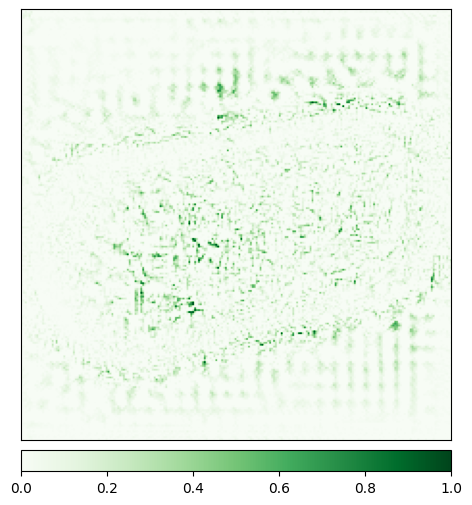

integrated gradients with noise tunnel


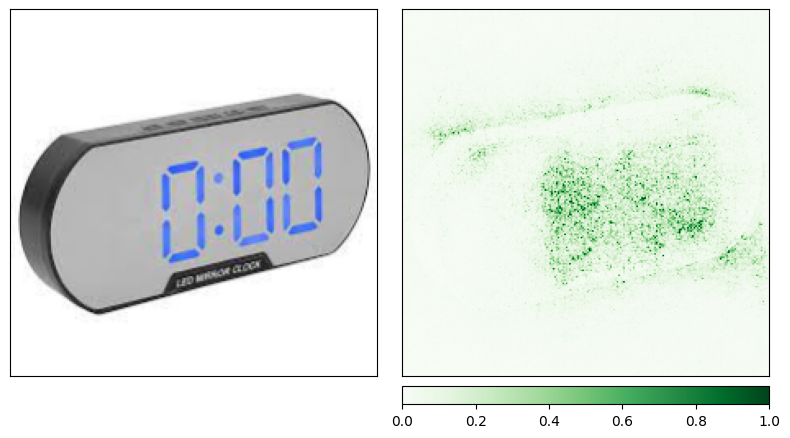

Input Tensor 0 did not already require gradients, required_grads has been set automatically.


Saliency Model Explanation: 


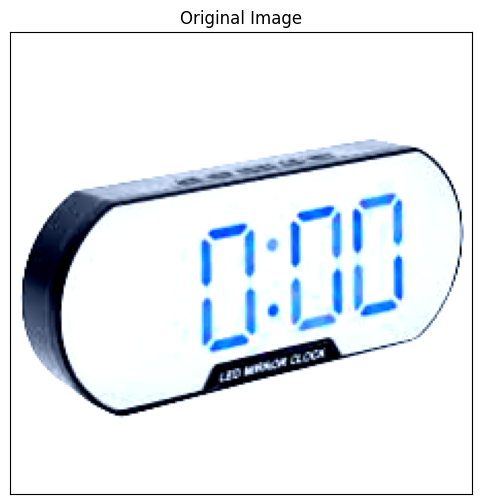

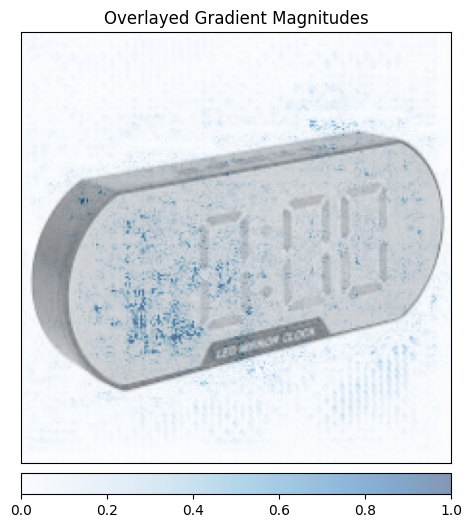

Occlusion Model Explainability: 


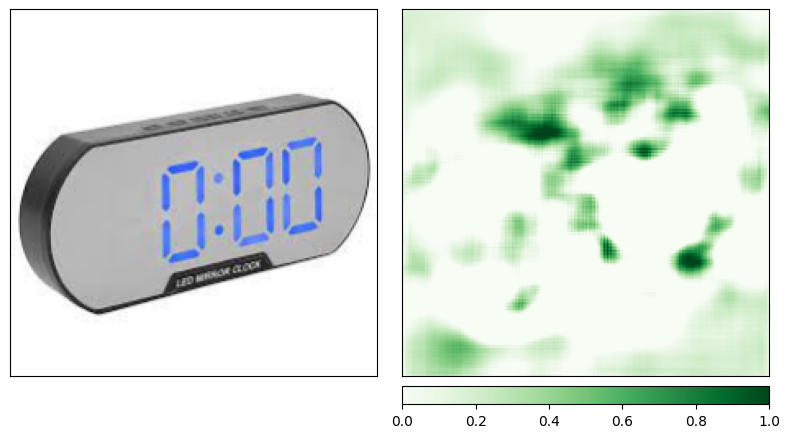

SHAP model explaiability: 


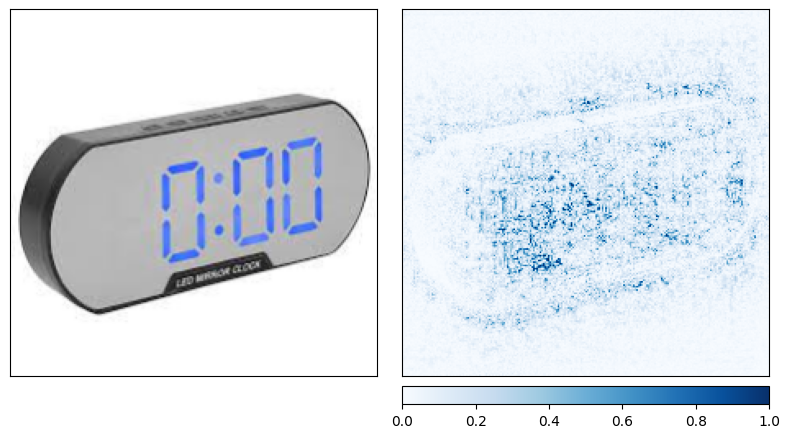

GRAD model explainability: 


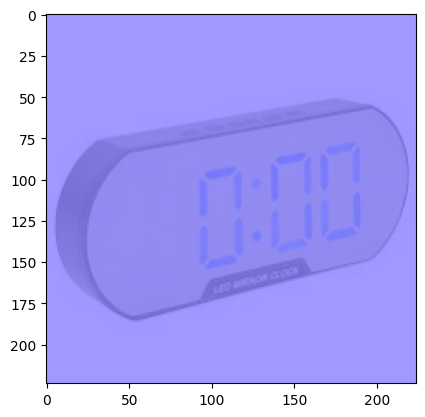

code for GRAD++


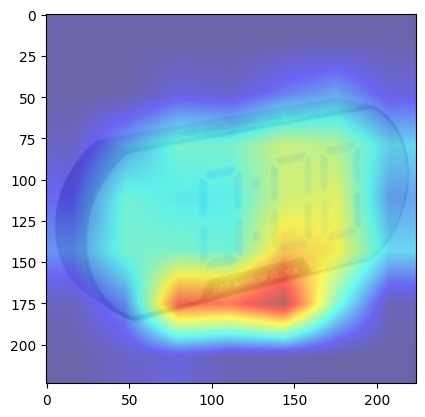

Processing image:  2dig_watch.jpg
Predicted: digital watch ( 0.5624004006385803 )
Integrated Gradients Model Explinability: 


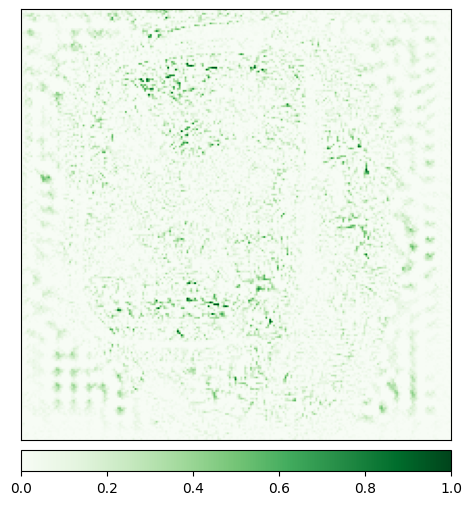

integrated gradients with noise tunnel


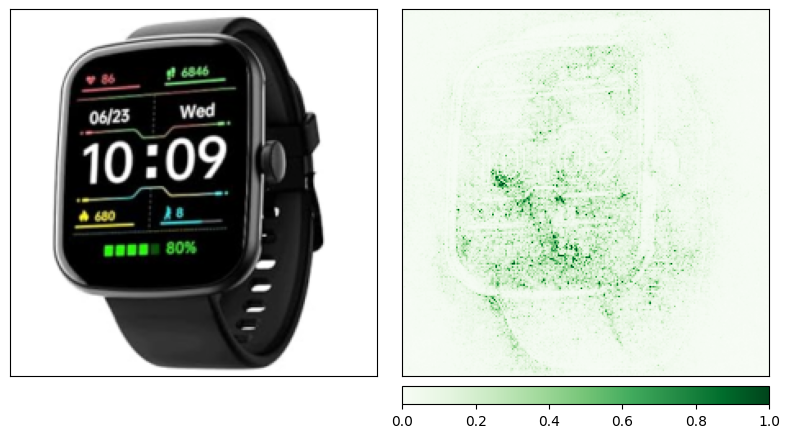

Saliency Model Explanation: 


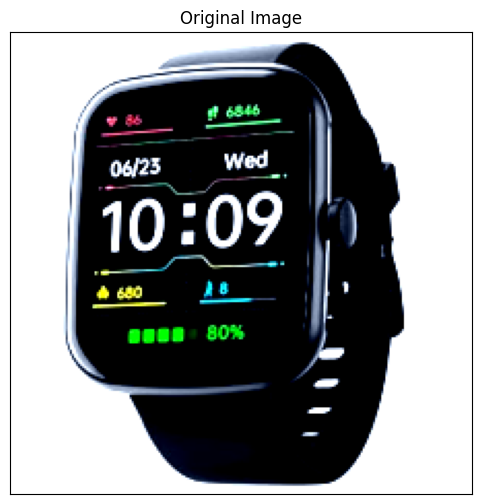

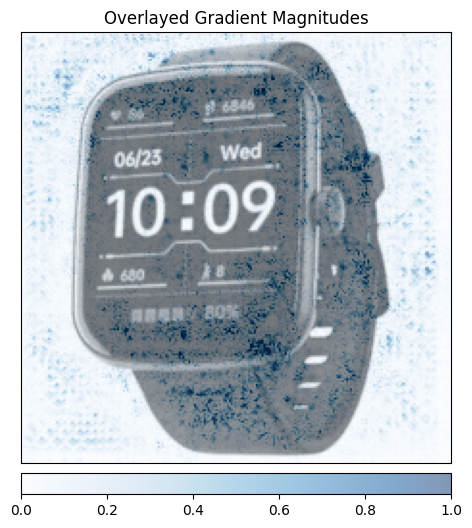

Occlusion Model Explainability: 


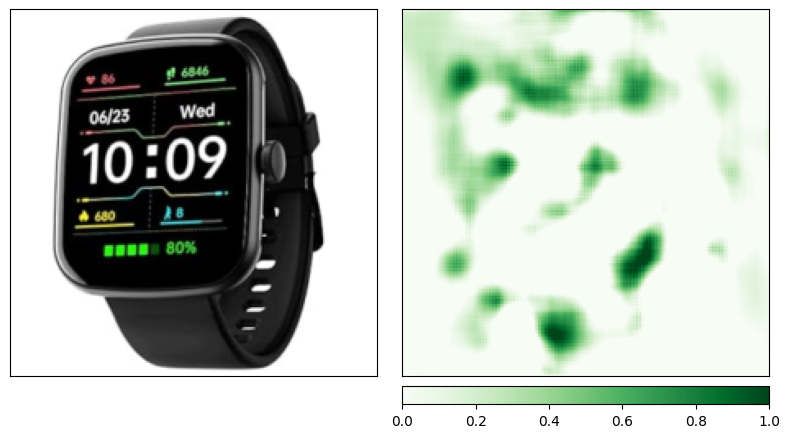

SHAP model explaiability: 


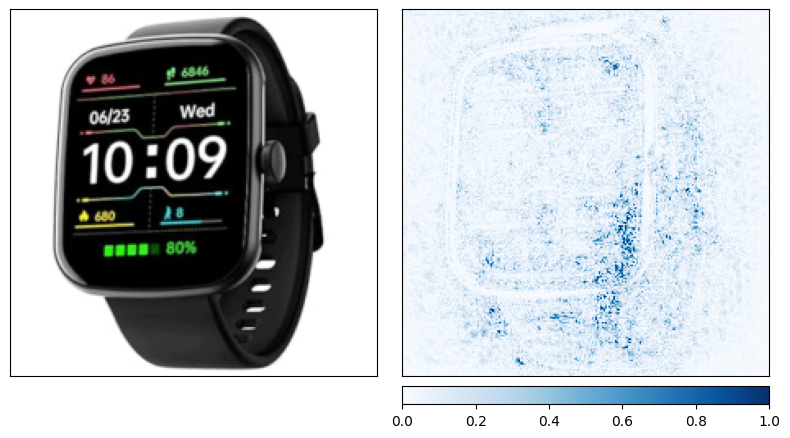

GRAD model explainability: 


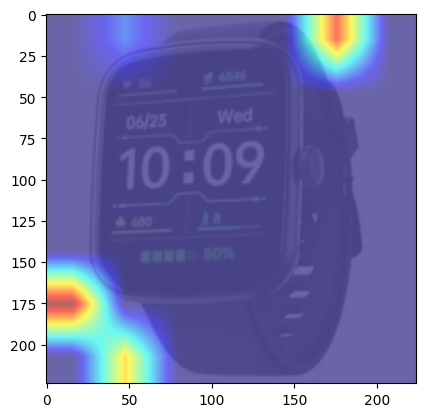

code for GRAD++


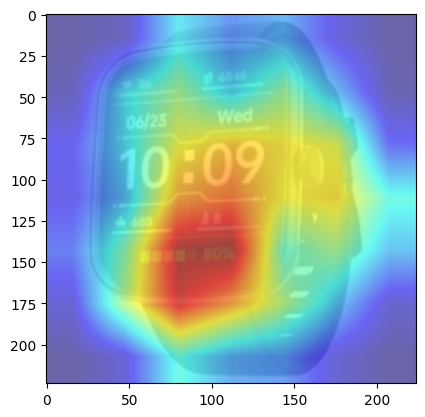

Processing image:  3din_tab.jpg
Predicted: dining table ( 0.7291280627250671 )
Integrated Gradients Model Explinability: 


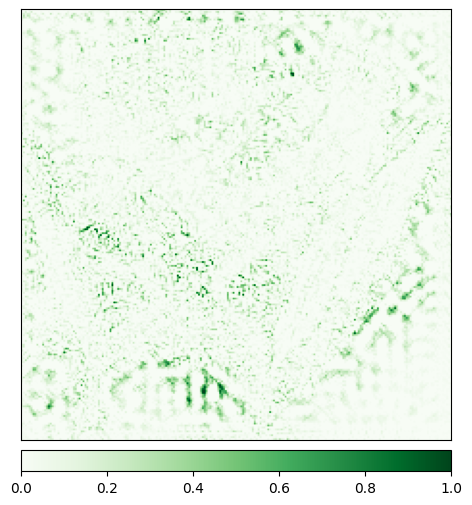

integrated gradients with noise tunnel


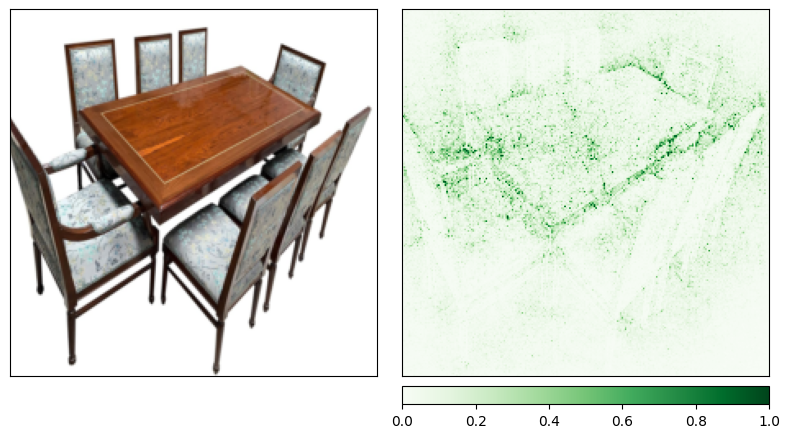

Saliency Model Explanation: 


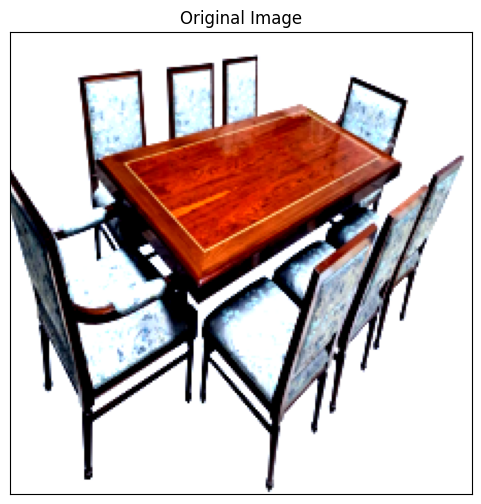

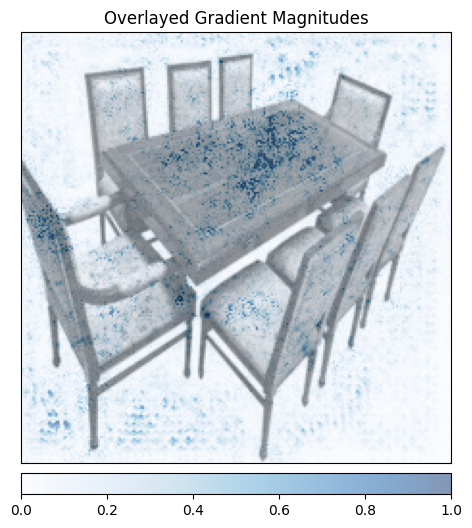

Occlusion Model Explainability: 


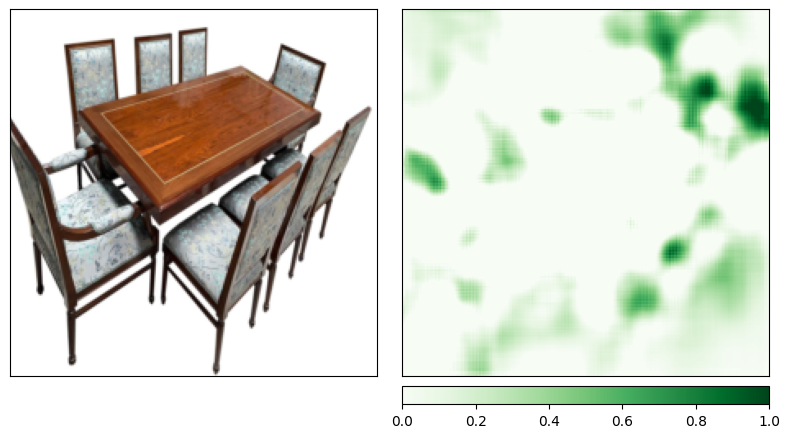

SHAP model explaiability: 


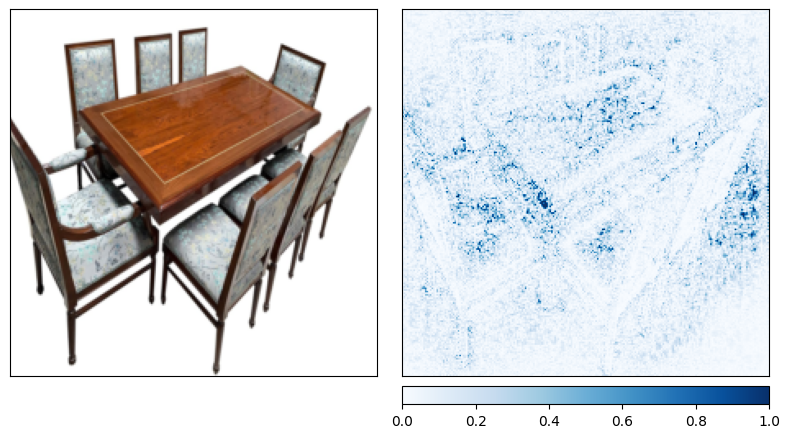

GRAD model explainability: 


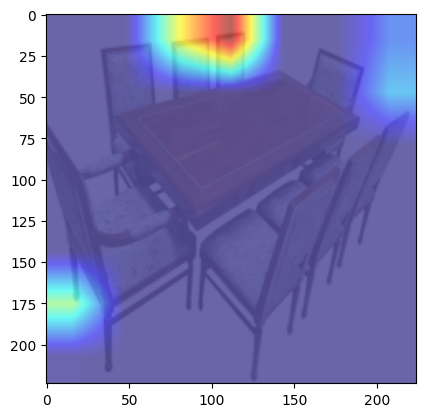

code for GRAD++


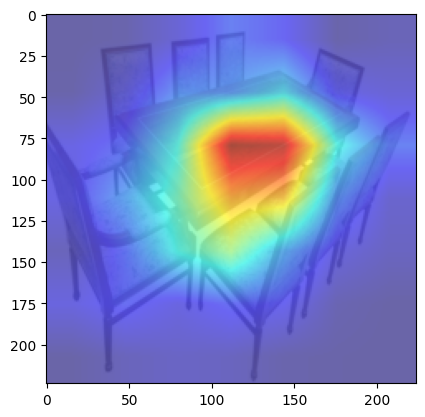

Processing image:  4_desk.jpg
Predicted: folding chair ( 0.41150593757629395 )
Integrated Gradients Model Explinability: 


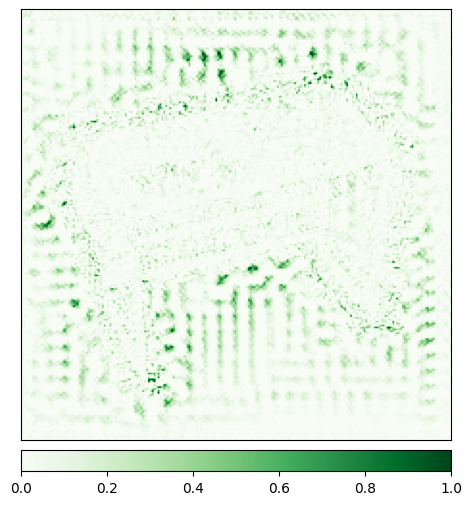

integrated gradients with noise tunnel


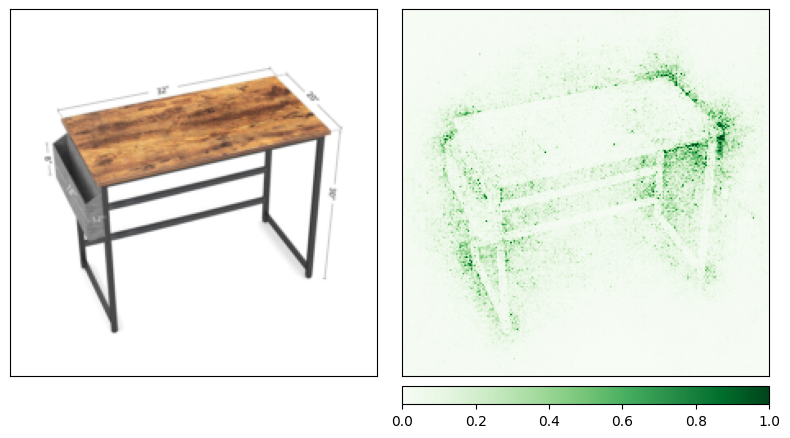

Saliency Model Explanation: 


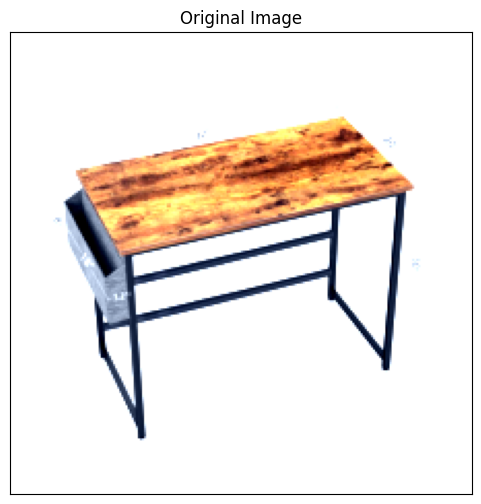

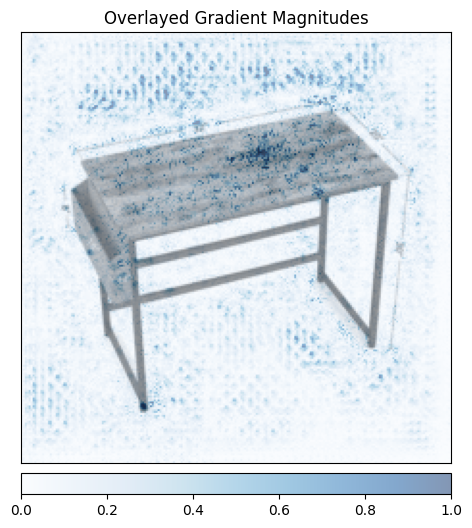

Occlusion Model Explainability: 


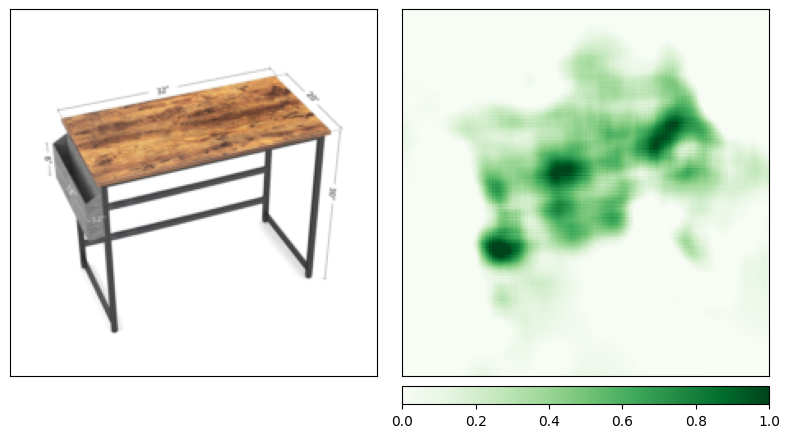

SHAP model explaiability: 


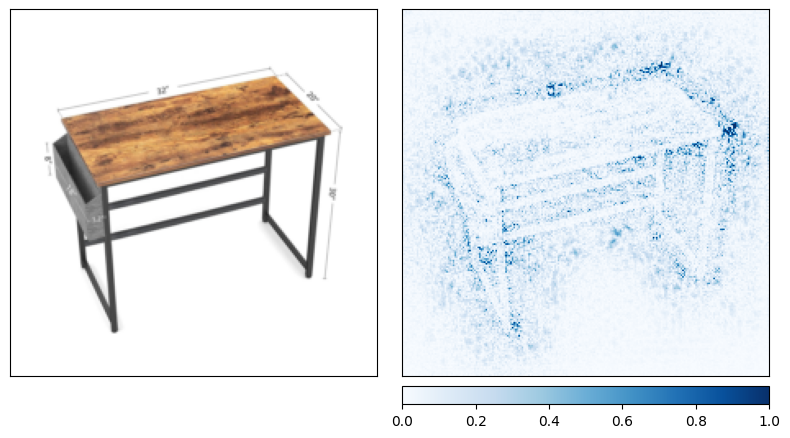

GRAD model explainability: 


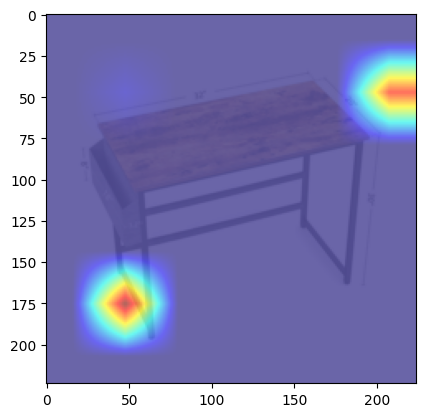

code for GRAD++


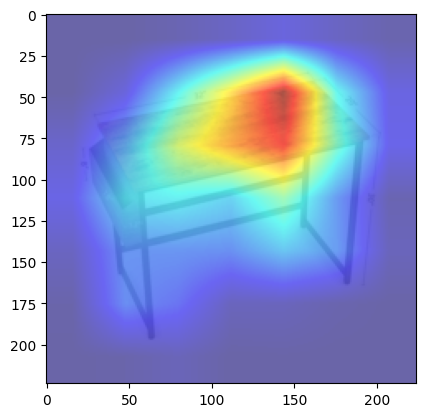

Processing image:  5_elguitar.jpg
Predicted: electric guitar ( 0.9996861219406128 )
Integrated Gradients Model Explinability: 


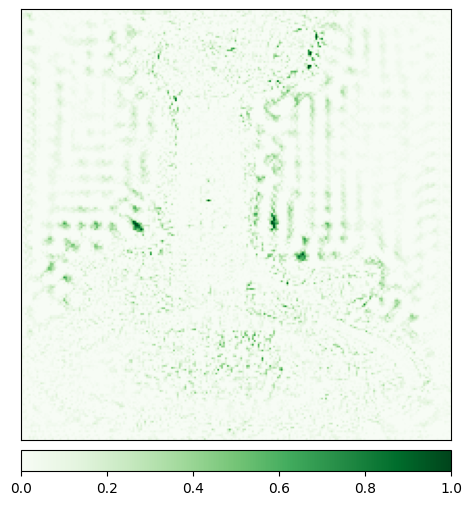

integrated gradients with noise tunnel


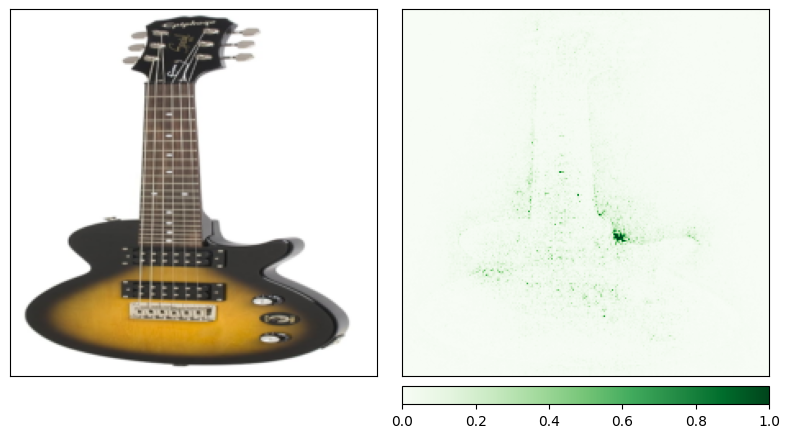

Saliency Model Explanation: 


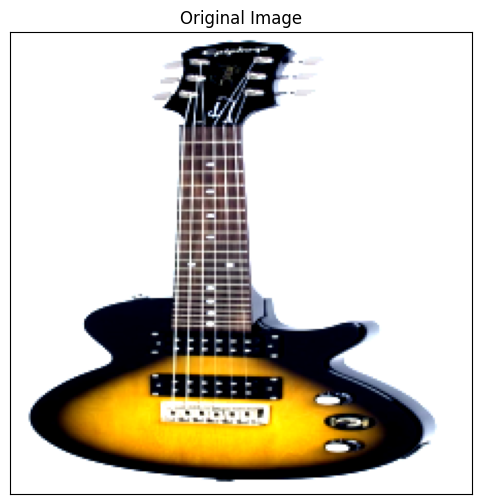

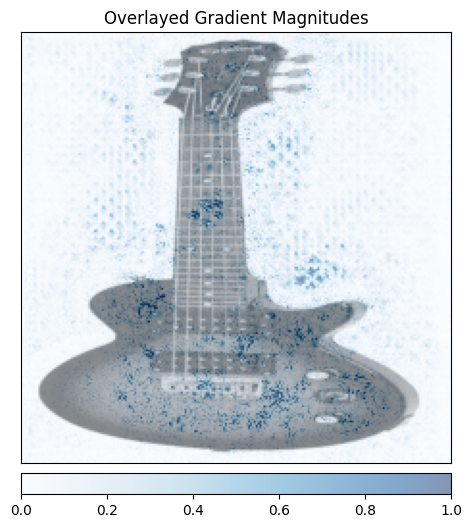

Occlusion Model Explainability: 


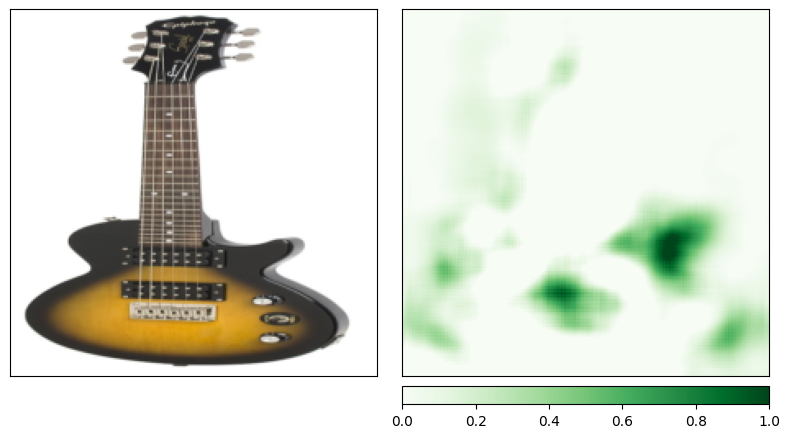

SHAP model explaiability: 


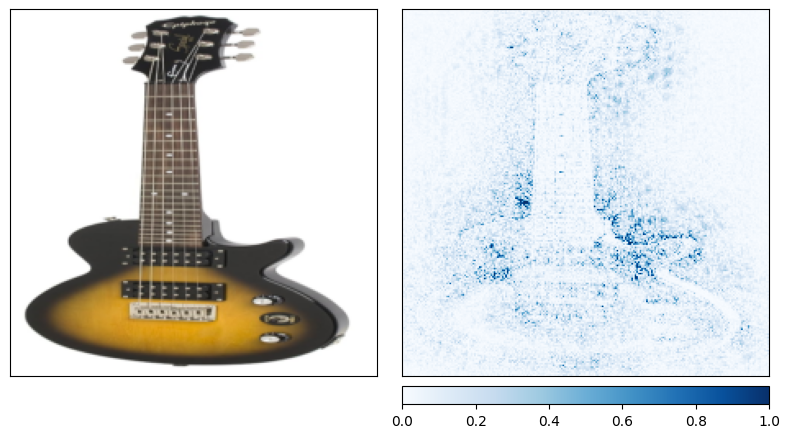

GRAD model explainability: 


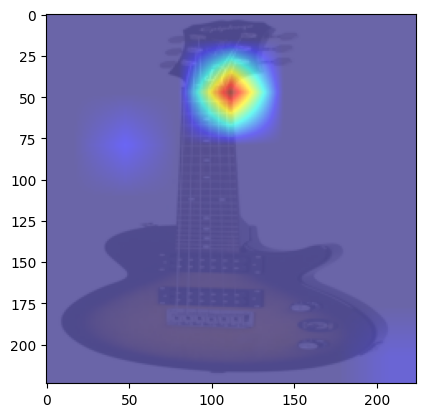

code for GRAD++


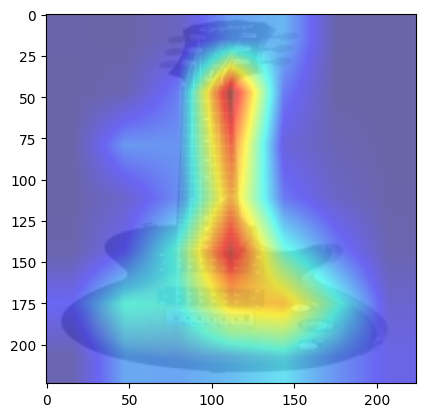

Processing image:  6_decomp.jpg
Predicted: desktop computer ( 0.954017698764801 )
Integrated Gradients Model Explinability: 


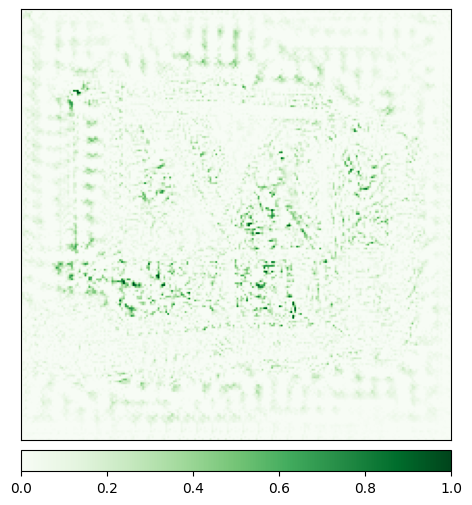

integrated gradients with noise tunnel


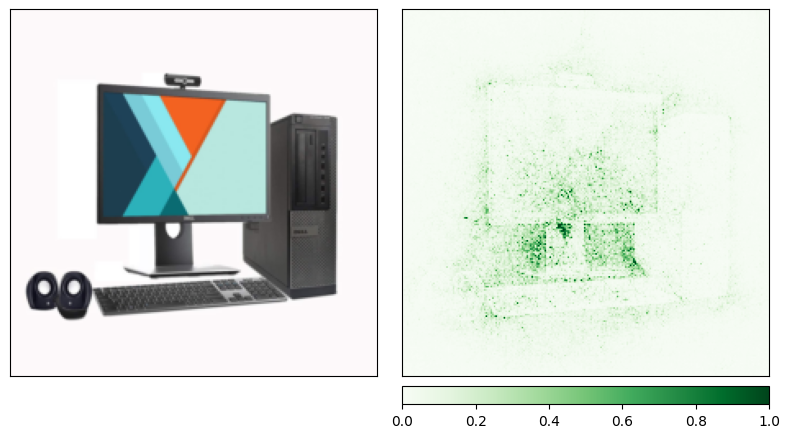

Saliency Model Explanation: 


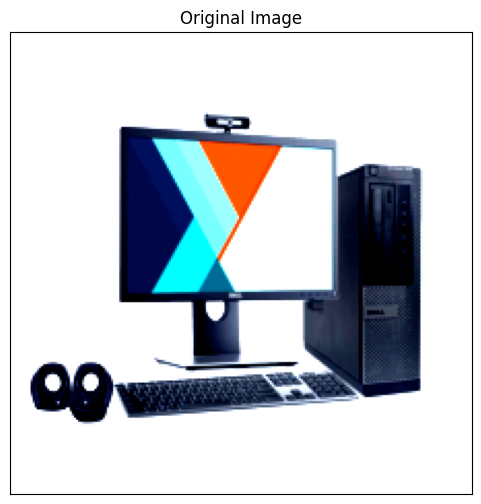

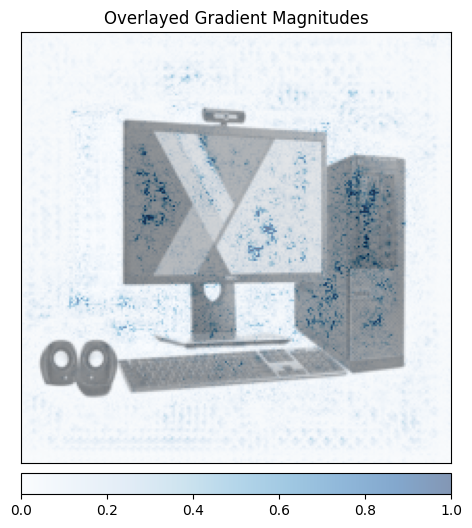

Occlusion Model Explainability: 


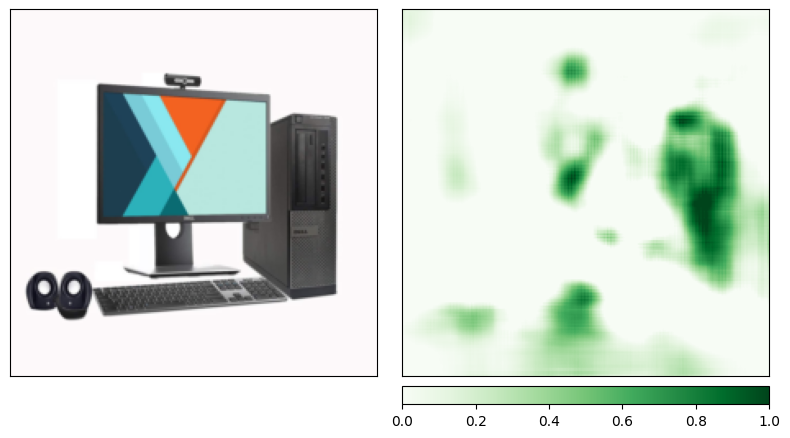

SHAP model explaiability: 


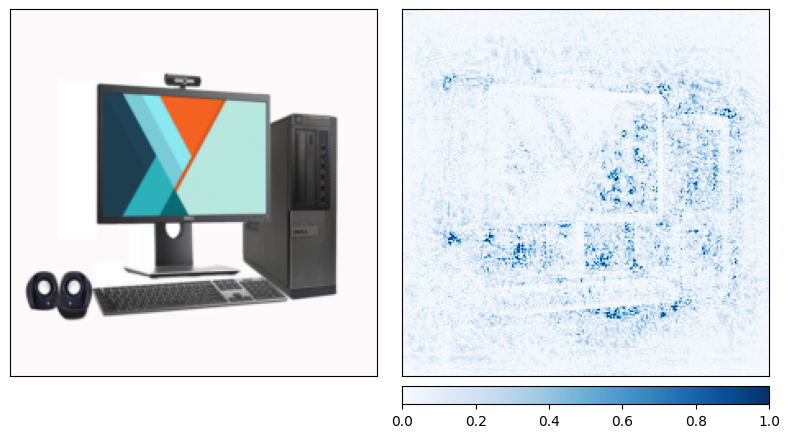

GRAD model explainability: 


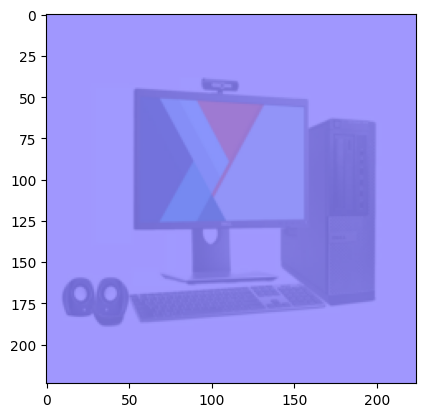

code for GRAD++


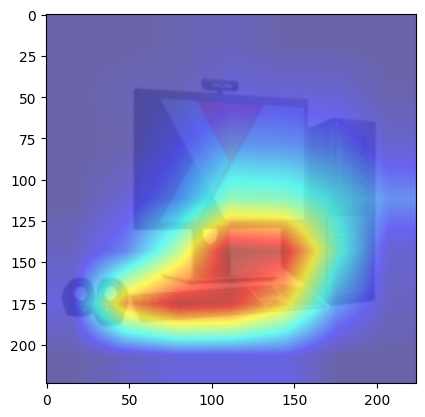

Processing image:  7.jpg
Predicted: neck brace ( 0.5180845856666565 )
Integrated Gradients Model Explinability: 


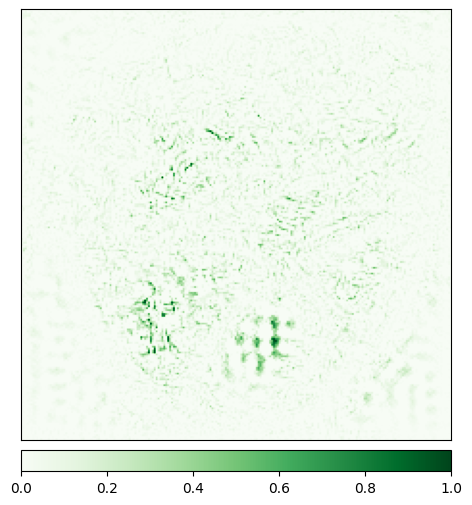

integrated gradients with noise tunnel


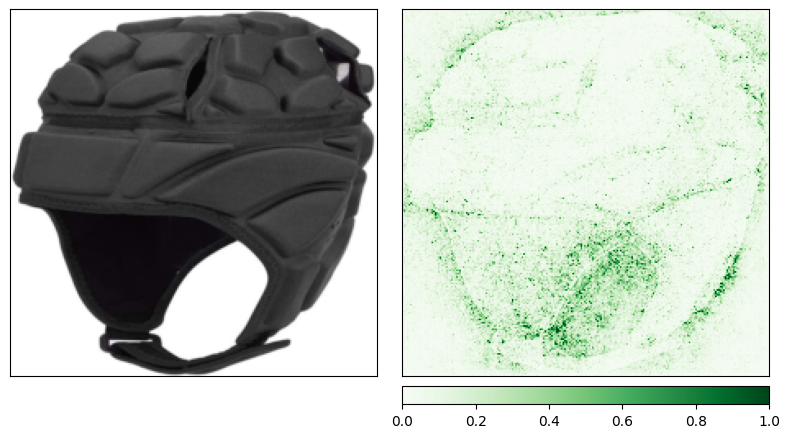

Saliency Model Explanation: 


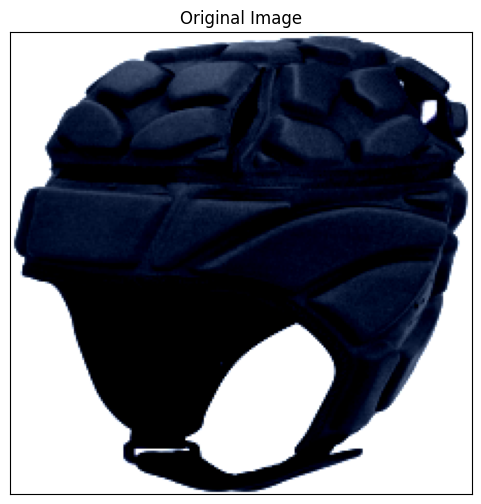

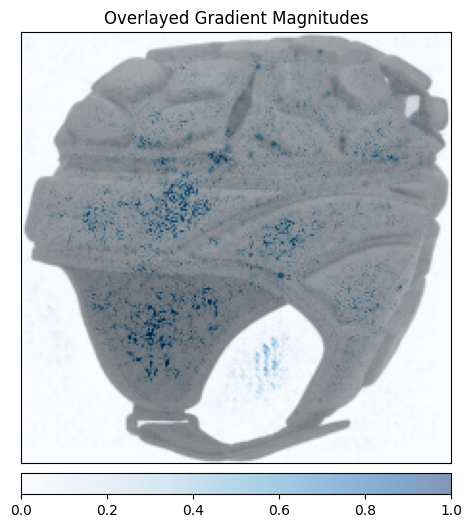

Occlusion Model Explainability: 


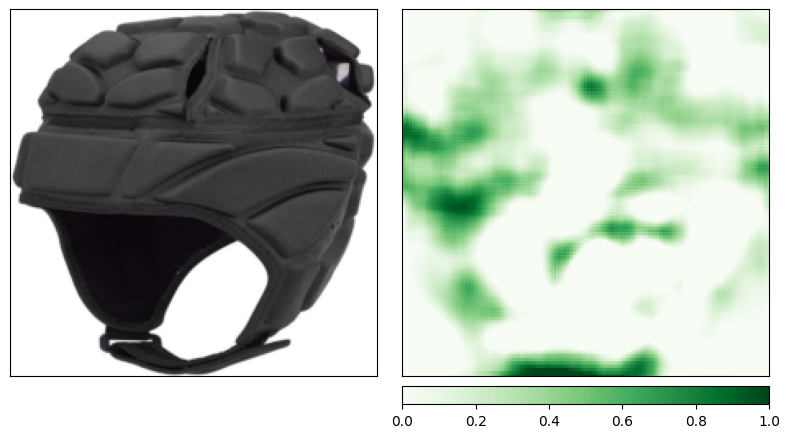

SHAP model explaiability: 


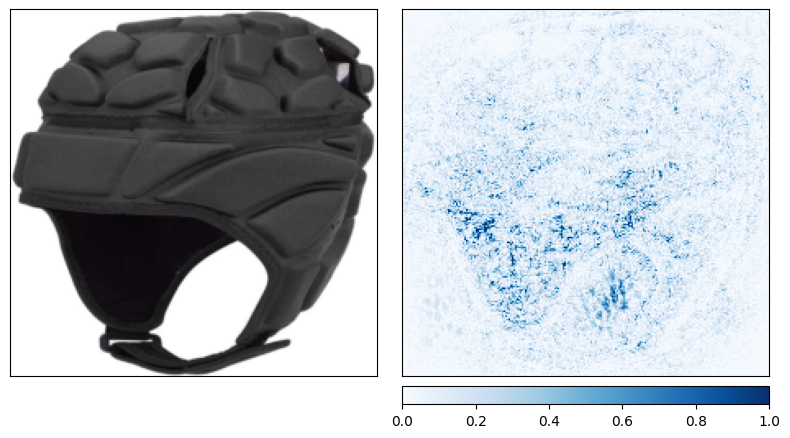

GRAD model explainability: 


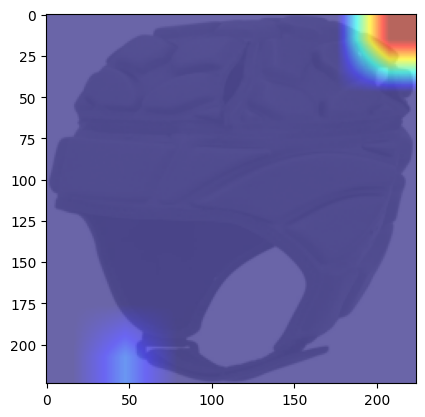

code for GRAD++


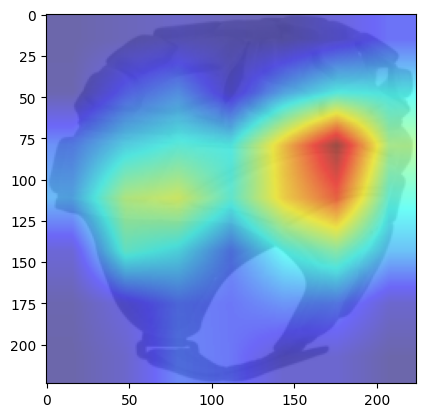

Processing image:  8.jpg
Predicted: face powder ( 0.9995369911193848 )
Integrated Gradients Model Explinability: 


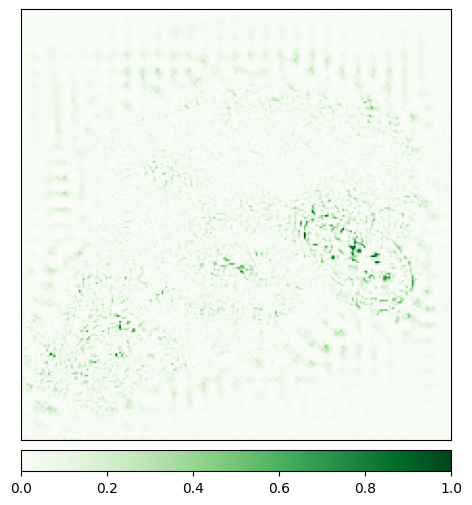

integrated gradients with noise tunnel


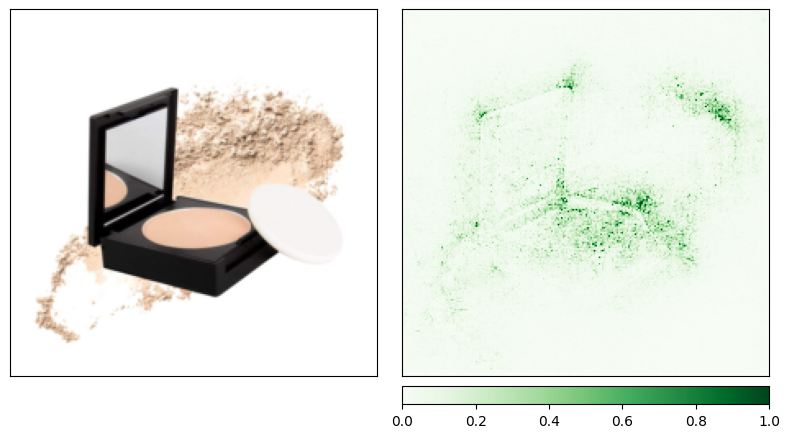

Saliency Model Explanation: 


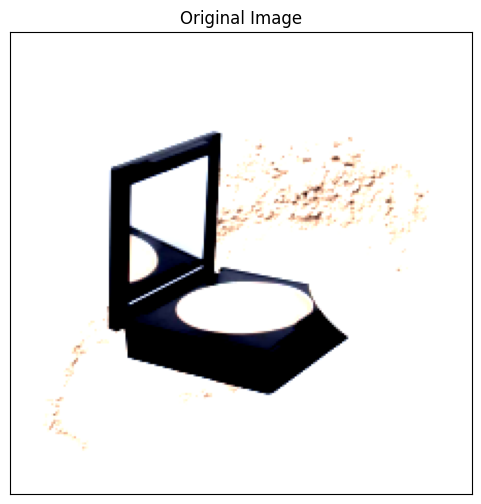

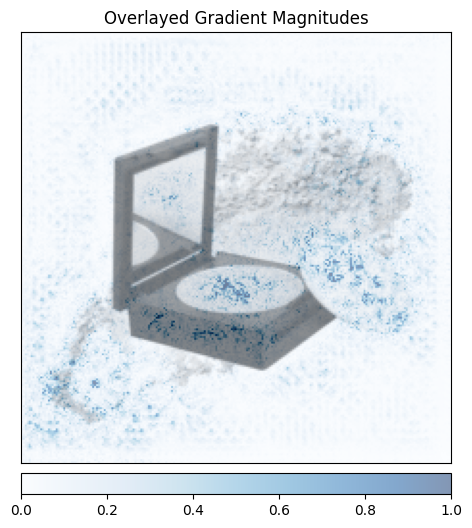

Occlusion Model Explainability: 


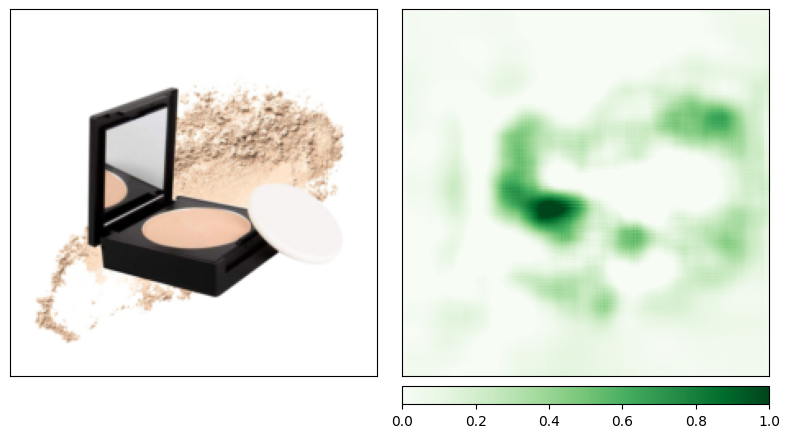

SHAP model explaiability: 


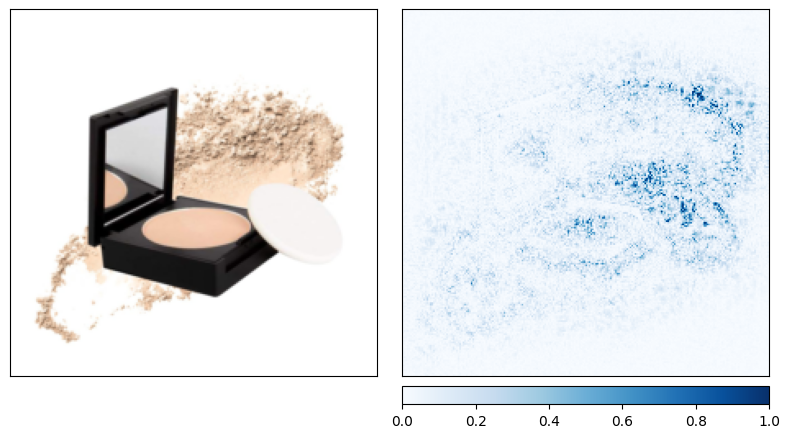

GRAD model explainability: 


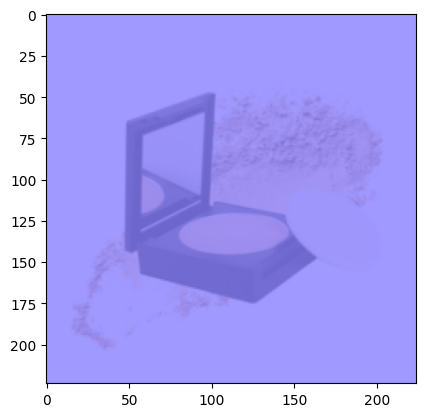

code for GRAD++


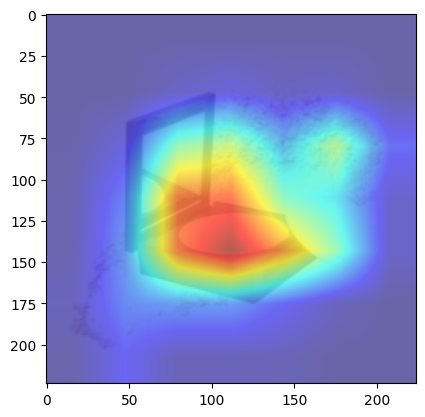

Processing image:  9.jpg
Predicted: envelope ( 0.32102081179618835 )
Integrated Gradients Model Explinability: 


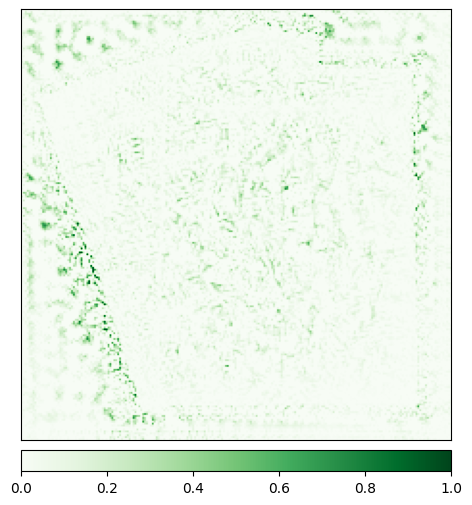

integrated gradients with noise tunnel


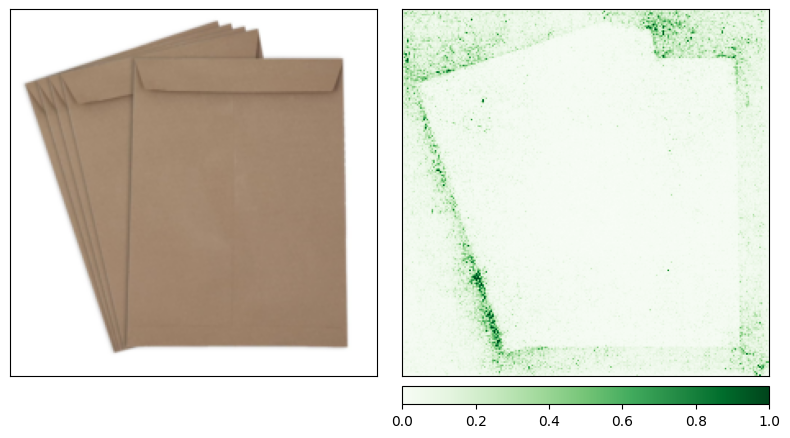

Saliency Model Explanation: 


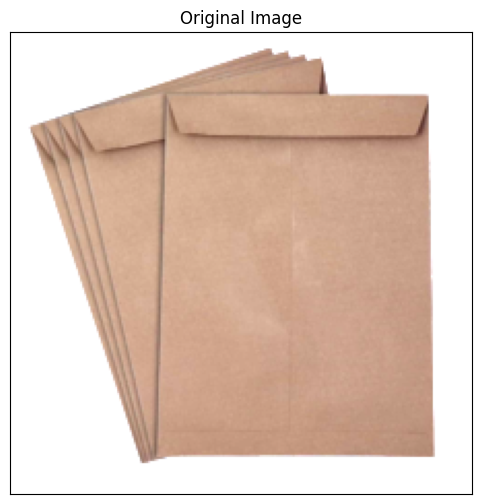

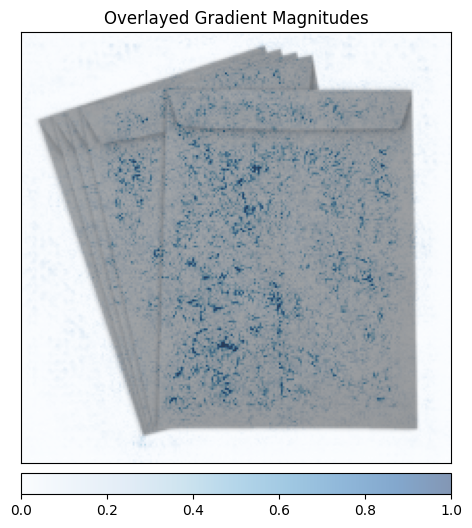

Occlusion Model Explainability: 


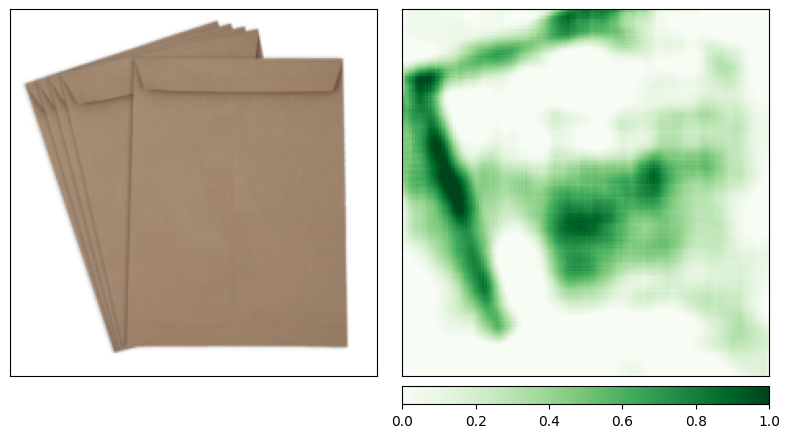

SHAP model explaiability: 


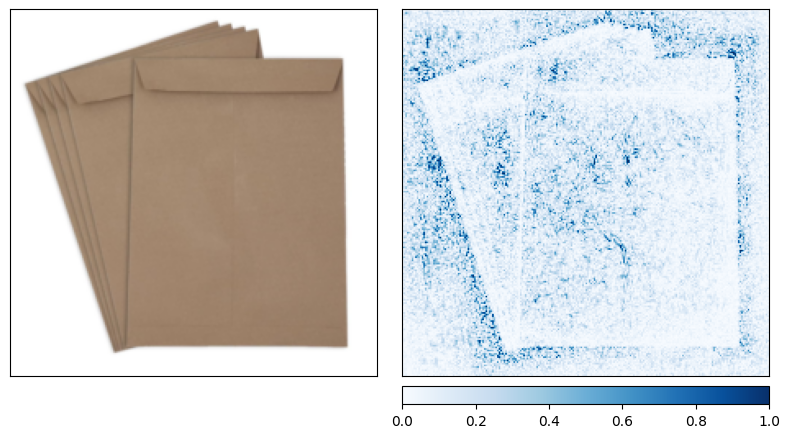

GRAD model explainability: 


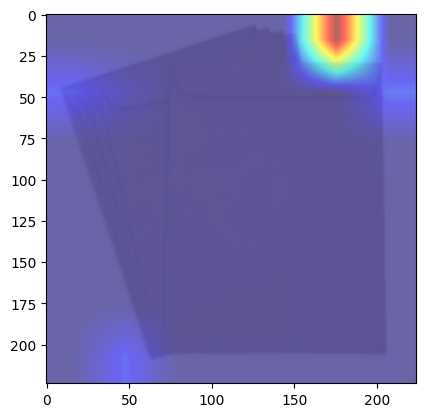

code for GRAD++


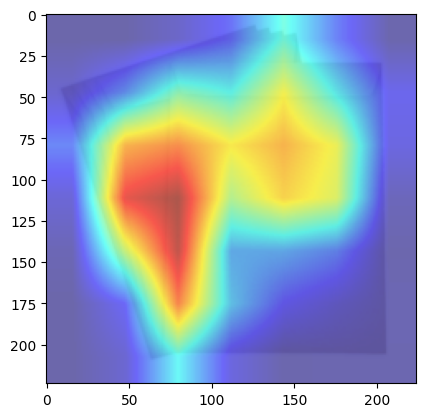

Processing image:  10.jpg
Predicted: espresso maker ( 0.999544084072113 )
Integrated Gradients Model Explinability: 


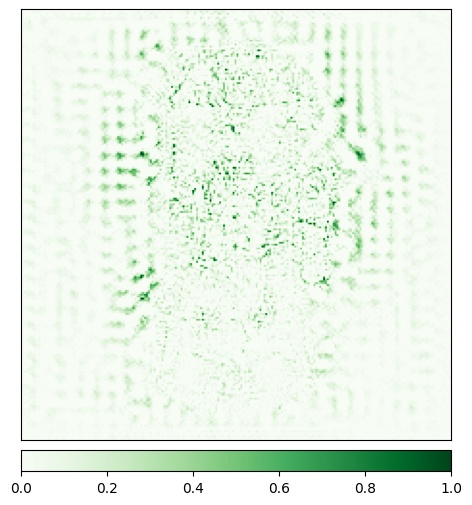

integrated gradients with noise tunnel


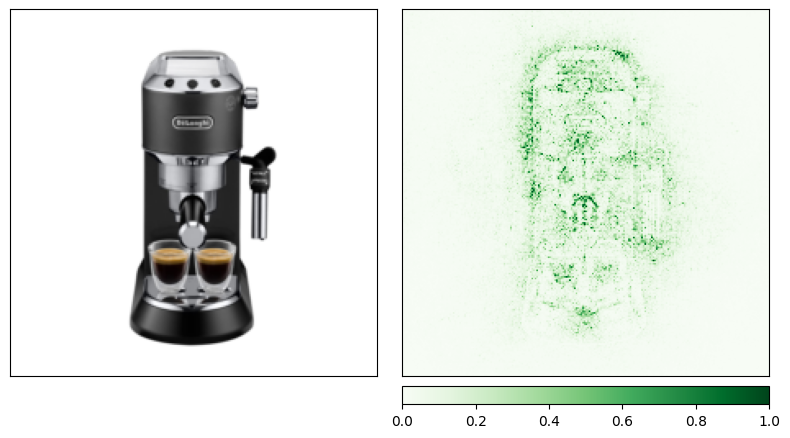

Saliency Model Explanation: 


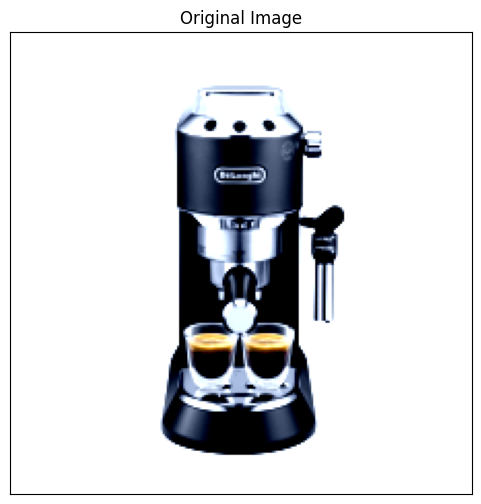

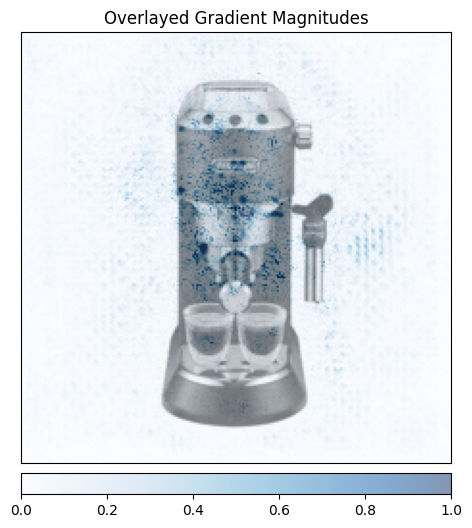

Occlusion Model Explainability: 


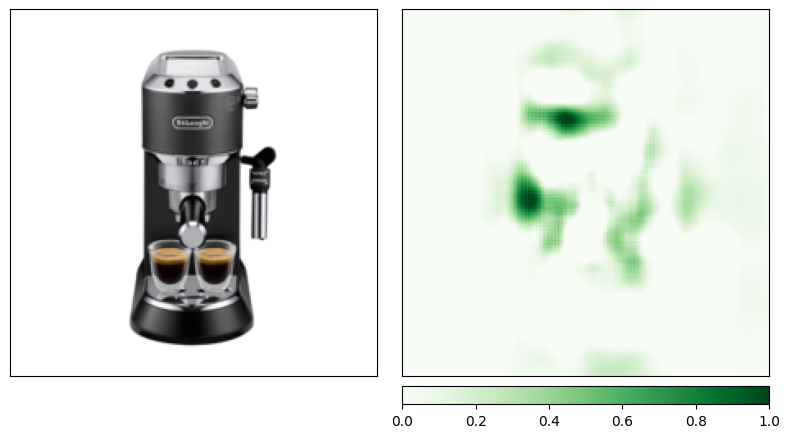

SHAP model explaiability: 


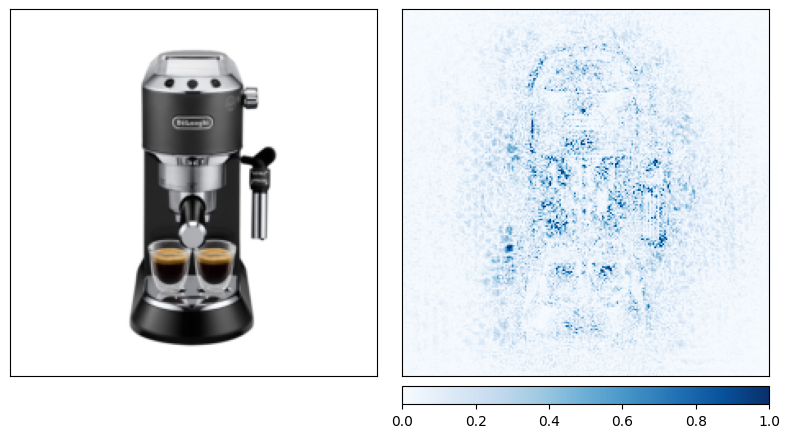

GRAD model explainability: 


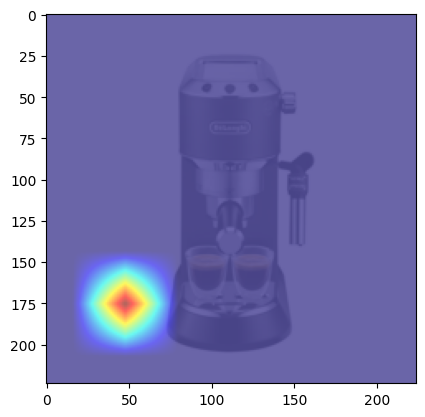

code for GRAD++


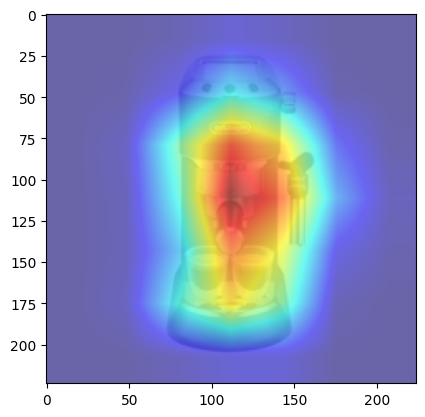

In [15]:

import urllib
import os
# import gradio as gr
import torch
import timm
import numpy as np

from PIL import Image
from timm.data import resolve_data_config
from timm.data.transforms_factory import create_transform

import torchvision.transforms as T
import torch.nn.functional as F
from matplotlib.colors import LinearSegmentedColormap

from typing import Dict

from captum.attr import IntegratedGradients
from captum.attr import GradientShap
from captum.attr import Occlusion
from captum.attr import NoiseTunnel
from captum.attr import visualization as viz

from captum.attr import Saliency
from captum.attr import DeepLift
#imports specifically for gradcam:
import timm
import torch
import torchvision.transforms as T
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from pytorch_grad_cam import GradCAM, HiResCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM, FullGrad
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
from pytorch_grad_cam import GradCAMPlusPlus
import shap


MODEL: str = "resnet18"

model = timm.create_model(MODEL, pretrained=True)
model.eval()
model = model.to(device)
url, filename = (
    "https://raw.githubusercontent.com/pytorch/hub/master/imagenet_classes.txt",
    "imagenet_classes.txt",
)
urllib.request.urlretrieve(url, filename)
with open("imagenet_classes.txt", "r") as f:
    categories = [s.strip() for s in f.readlines()]

transform = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor()
])

transform_normalize = T.Normalize(
     mean=[0.485, 0.456, 0.406],
     std=[0.229, 0.224, 0.225]
)

images = os.listdir("/content/drive/MyDrive/img_dir/")
for image in images:
    #create model then perform prediction
    print("Processing image: ", image)
    img = Image.open('/content/drive/MyDrive/img_dir/' + image)
    transformed_img = transform(img)
    img_tensor = transform_normalize(transformed_img)
    img_tensor = img_tensor.unsqueeze(0)
    img_tensor = img_tensor.to(device)
    with torch.no_grad():
        output = model(img_tensor)
    output = F.softmax(output, dim=1)
    prediction_score, pred_label_idx = torch.topk(output, 1)
    pred_label_idx.squeeze_()
    predicted_label = categories[pred_label_idx.item()]
    print('Predicted:', predicted_label, '(', prediction_score.squeeze().item(), ')')

    #code for IG
    print('Integrated Gradients Model Explinability: ')
    integrated_gradients = IntegratedGradients(model)
    default_cmap = LinearSegmentedColormap.from_list('custom blue',
                                                 [(0, '#ffffff'),
                                                  (1, '#000000')], N=256)
    attributions_ig = integrated_gradients.attribute(img_tensor, target=285, n_steps=400)

    sth = viz.visualize_image_attr(np.transpose(attributions_ig.squeeze().cpu().detach().numpy(), (1, 2, 0)),
                                np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1, 2, 0)),
                                method='heat_map',
                                #  cmap=default_cmap,
                                show_colorbar=True,
                                sign='positive',
                                outlier_perc=1)

    sth[0].savefig('/content/s7/output/' + image + "_ig.png")
    #code for IG with Noise Tunnel
    print('integrated gradients with noise tunnel')
    noise_tunnel = NoiseTunnel(integrated_gradients)

    attributions_ig_nt = noise_tunnel.attribute(img_tensor, nt_samples=10, nt_type='smoothgrad_sq', target=pred_label_idx)
    sth = viz.visualize_image_attr_multiple(np.transpose(attributions_ig_nt.squeeze().cpu().detach().numpy(), (1, 2, 0)),
                                        np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1, 2, 0)),
                                        ["original_image", "heat_map"],
                                        ["all", "positive"],
                                        #   cmap=default_cmap,
                                        show_colorbar=True)

    sth[0].savefig('/content/s7/output/' + image + "_ig_WnoiseTunnel.png")

    #code for saliency:
    print('Saliency Model Explanation: ')
    saliency = Saliency(model)
    grads = saliency.attribute(img_tensor, target=285)
    grads = np.transpose(grads.squeeze().cpu().detach().numpy(), (1, 2, 0))
    original_image = np.transpose((img_tensor.squeeze(0).cpu().detach().numpy() / 2) + 0.5, (1, 2, 0))
    sth = viz.visualize_image_attr(None, original_image,
                        method="original_image", title="Original Image")
    sth = viz.visualize_image_attr(grads, original_image, method="blended_heat_map", sign="absolute_value",
                            show_colorbar=True, title="Overlayed Gradient Magnitudes")

    sth[0].savefig('/content/s7/output/' + image + "_saliency.png")

    #code for Occlusion
    print('Occlusion Model Explainability: ')
    occlusion = Occlusion(model)

    attributions_occ = occlusion.attribute(img_tensor,
                                        strides = (3, 2, 2),
                                        target=pred_label_idx,
                                        sliding_window_shapes=(3, 15, 15),
                                        baselines=0)
    sth = viz.visualize_image_attr_multiple(np.transpose(attributions_occ.squeeze().cpu().detach().numpy(), (1,2,0)),
                                        np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1,2,0)),
                                        ["original_image", "heat_map"],
                                        ["all", "positive"],
                                        show_colorbar=True,
                                        outlier_perc=2,
                                        )
    sth[0].savefig('/content/s7/output/' + image + "_occlusion.png")

    #code for SHAP (works well where number of classes are less)
    print('SHAP model explaiability: ')
    gradient_shap = GradientShap(model)

    # Defining baseline distribution of images
    rand_img_dist = torch.cat([img_tensor * 0, img_tensor * 1])

    attributions_gs = gradient_shap.attribute(img_tensor,
                                            n_samples=50,
                                            stdevs=0.0001,
                                            baselines=rand_img_dist,
                                            target=pred_label_idx)
    sth = viz.visualize_image_attr_multiple(np.transpose(attributions_gs.squeeze().cpu().detach().numpy(), (1,2,0)),
                                        np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1,2,0)),
                                        ["original_image", "heat_map"],
                                        ["all", "absolute_value"],
                                        #   cmap=default_cmap,
                                        show_colorbar=True)
    sth[0].savefig('/content/s7/output/' + image + "_SHAP.png")
    #code for GRAD
    print('GRAD model explainability: ')
    img_copy =  Image.open('/content/drive/MyDrive/img_dir/' + image)
    img_tensor = transform(img_copy)       #overriding image tensor.
    img_tensor = img_tensor.unsqueeze(0)
    img_tensor.requires_grad = True
    img_tensor = img_tensor.to(device)
    mean = [0.485, 0.456, 0.406]
    std  = [0.229, 0.224, 0.225]
    inv_transform = T.Compose([
        # T.Lambda(lambda x: x.permute(0, 2, 3, 1)),
        T.Normalize(
            mean = (-1 * np.array(mean) / np.array(std)).tolist(),
            std = (1 / np.array(std)).tolist()
        ),
        # T.Lambda(lambda x: x.permute(0, 3, 1, 2)),
    ])
    target_layers = [model.layer4[-1]]
    cam = GradCAM(model=model, target_layers=target_layers, use_cuda=True)
    targets = [ClassifierOutputTarget(285)]

    # You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
    grayscale_cam = cam(input_tensor=img_tensor, targets=targets)
    grayscale_cam = grayscale_cam[0, :]
    rgb_img = inv_transform(img_tensor).cpu().squeeze().permute(1, 2, 0).detach().numpy()
    visualization = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
    plt.imshow(visualization)
    plt.show()
    Image.fromarray(visualization).save('/content/s7/output/' + image + "_gradcam.jpeg")
    #code for GRAD++
    print('code for GRAD++')
    cam = GradCAMPlusPlus(model=model, target_layers=target_layers, use_cuda=True)
    grayscale_cam = cam(input_tensor=img_tensor, targets=targets)
    # In this example grayscale_cam has only one image in the batch:
    grayscale_cam = grayscale_cam[0, :]
    rgb_img = inv_transform(img_tensor).cpu().squeeze().permute(1, 2, 0).detach().numpy()
    visualization = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)
    plt.imshow(visualization)
    plt.show()
    Image.fromarray(visualization).save('/content/s7/output/' + image + "_gradcam++.jpeg")

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [7]:
#contains pretrained timm model
import urllib
import os
# import gradio as gr
import torch
import timm
import numpy as np

from PIL import Image
from timm.data import resolve_data_config
from timm.data.transforms_factory import create_transform

import torchvision.transforms as T
import torch.nn.functional as F
from matplotlib.colors import LinearSegmentedColormap

from typing import Dict

from captum.attr import IntegratedGradients
from captum.attr import GradientShap
from captum.attr import Occlusion
from captum.attr import NoiseTunnel
from captum.attr import visualization as viz

from captum.attr import Saliency
from captum.attr import DeepLift

#imports specifically for gradcam:
import timm
import torch
import torchvision.transforms as T
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from pytorch_grad_cam import GradCAM, HiResCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM, FullGrad
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
from pytorch_grad_cam import GradCAMPlusPlus

from captum.robust import FGSM
from captum.robust import PGD

transform = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
    T.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

def get_prediction(model, image: torch.Tensor):
    model = model.to(device)
    img_tensor = image.to(device)
    with torch.no_grad():
        output = model(img_tensor)
    output = F.softmax(output, dim=1)
    prediction_score, pred_label_idx = torch.topk(output, 1)

    pred_label_idx.squeeze_()
    predicted_label = categories[pred_label_idx.item()]

    return predicted_label, prediction_score.squeeze().item()

    # print('Predicted:', predicted_label, '(', prediction_score.squeeze().item(), ')')

def image_show(img, pred):
    npimg = inv_transform(img).squeeze().permute(1, 2, 0).detach().numpy()
    plt.imshow(npimg)
    plt.title("prediction: %s" % pred)
    plt.show()

original image: 


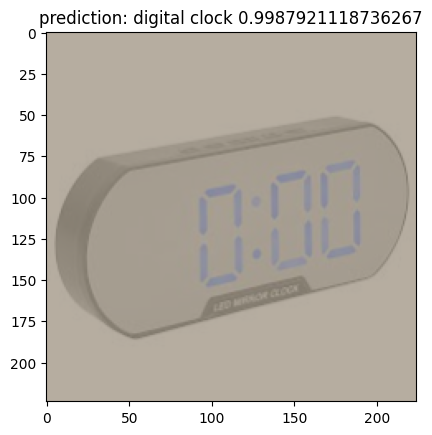

applying PGD: 


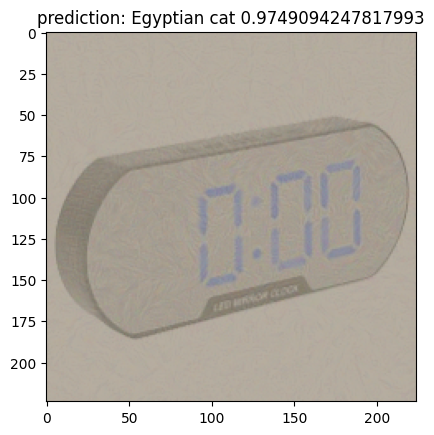

original image: 


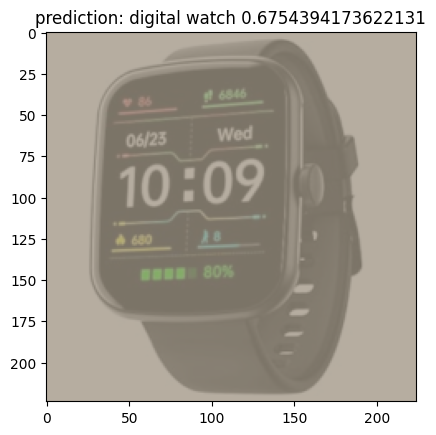

applying PGD: 


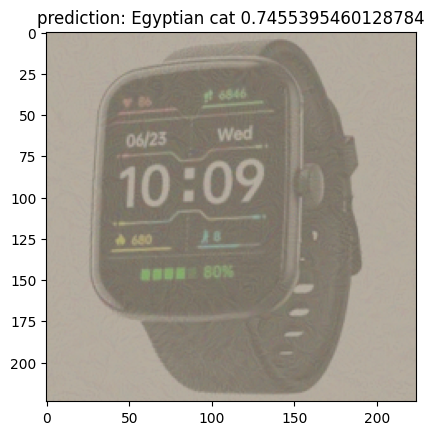

original image: 


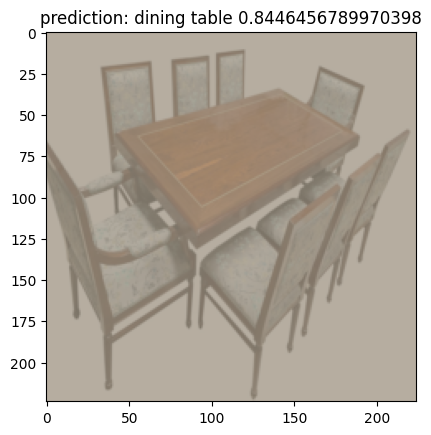

applying PGD: 


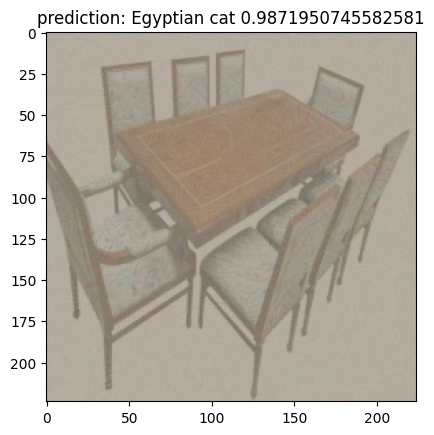

original image: 


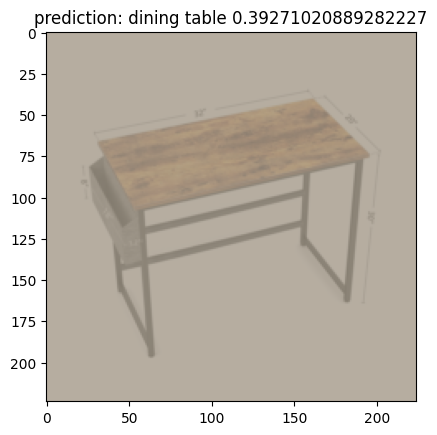

applying PGD: 


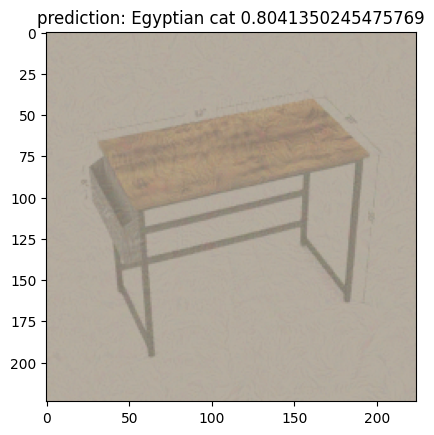

original image: 


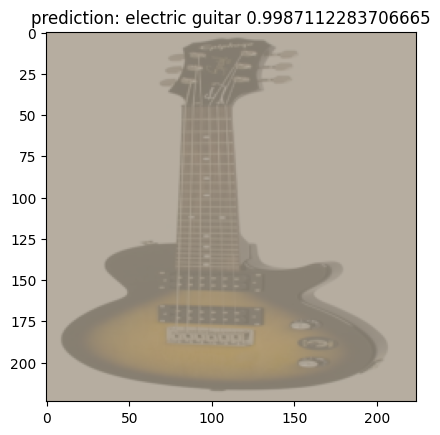

applying PGD: 


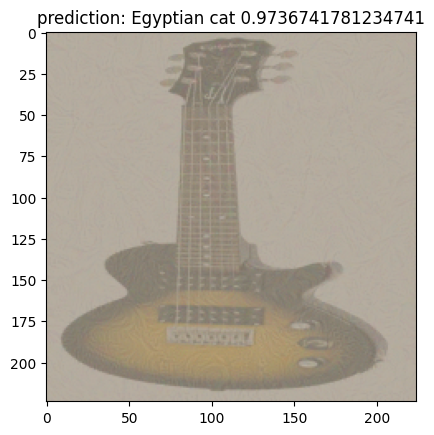

original image: 


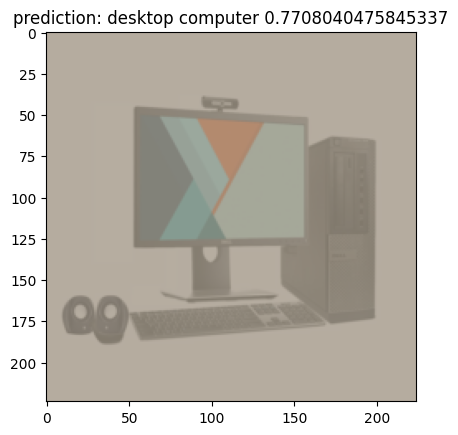

applying PGD: 


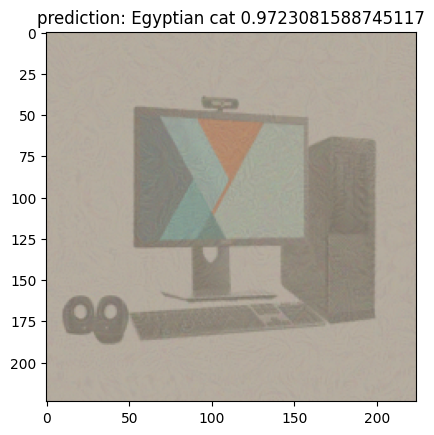

original image: 


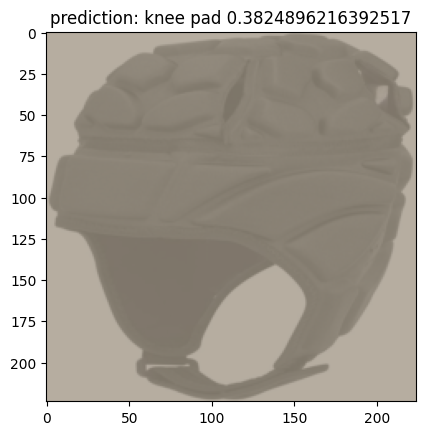

applying PGD: 


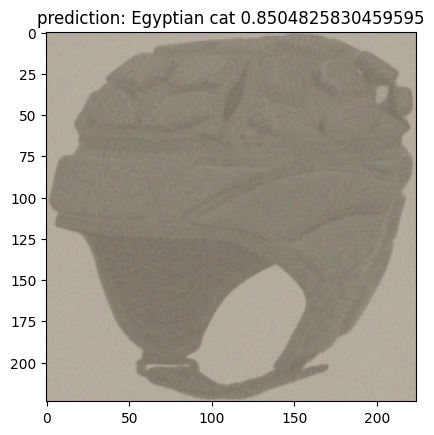

original image: 


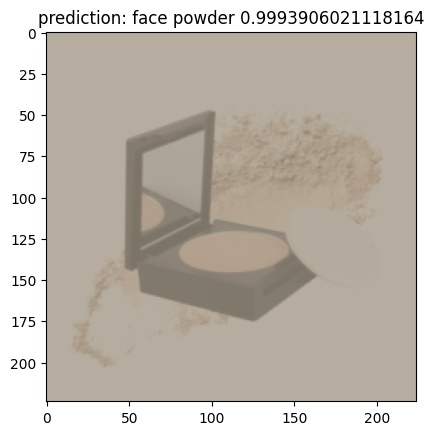

applying PGD: 


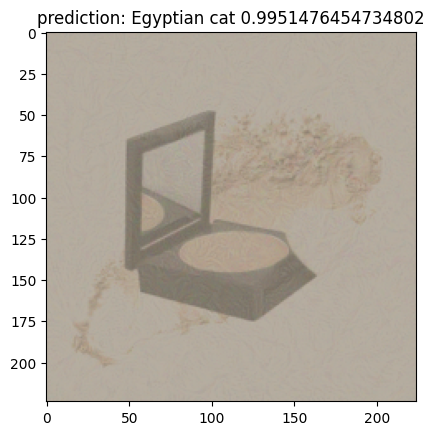

original image: 


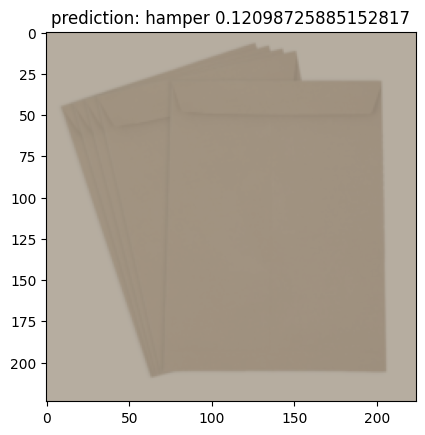

applying PGD: 


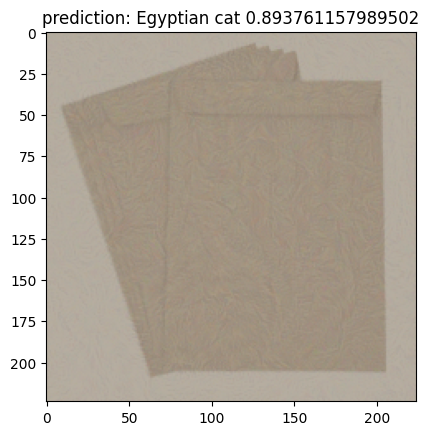

original image: 


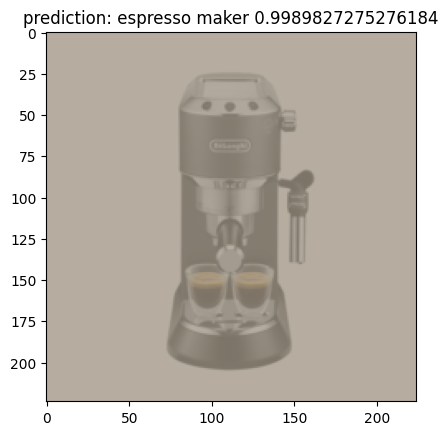

applying PGD: 


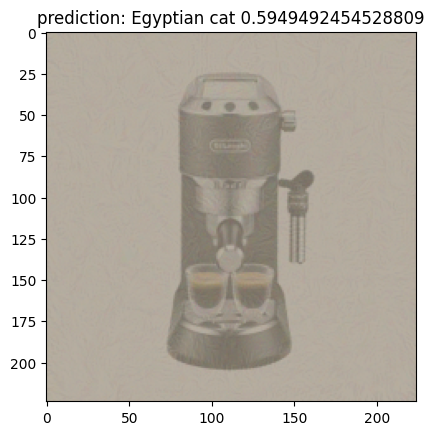

In [12]:
MODEL: str = "resnet18"

model = timm.create_model(MODEL, pretrained=True)
model.eval()
url, filename = (
    "https://raw.githubusercontent.com/pytorch/hub/master/imagenet_classes.txt",
    "imagenet_classes.txt",
)
urllib.request.urlretrieve(url, filename)
with open("imagenet_classes.txt", "r") as f:
    categories = [s.strip() for s in f.readlines()]

transform = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor()
])

transform_normalize = T.Normalize(
     mean=[0.485, 0.456, 0.406],
     std=[0.229, 0.224, 0.225]
)
images =  os.listdir("/content/drive/MyDrive/img_dir/")
for image in images:
    img =  Image.open('/content/drive/MyDrive/img_dir/' + image)
    img_tensor = transform(img)
    img_tensor = img_tensor.unsqueeze(0)
    img_tensor.requires_grad = True
    img_tensor = img_tensor.to(device)

    mean = [0.485, 0.456, 0.406]
    std  = [0.229, 0.224, 0.225]
    inv_transform= T.Compose([
        T.Normalize(
            mean = (-1 * np.array(mean) / np.array(std)).tolist(),
            std = (1 / np.array(std)).tolist()
        ),
    ])
    print('original image: ')
    pred, score  = get_prediction(model, img_tensor)
    image_show(img_tensor.cpu(), pred + " " + str(score))

    #code for PGD:
    print('applying PGD: ') #286 is egyptian cat
    pgd = PGD(model, torch.nn.CrossEntropyLoss(reduction='none'), lower_bound=-1, upper_bound=1)  # construct the PGD attacker
    perturbed_image_pgd = pgd.perturb(inputs=img_tensor, radius=0.13, step_size=0.02,
                                    step_num=7, target=torch.tensor([285]).to(device), targeted=True)
    new_pred_pgd, score_pgd = get_prediction(model, perturbed_image_pgd)
    image_show(perturbed_image_pgd.cpu(), new_pred_pgd + " " + str(score_pgd))



original image: 


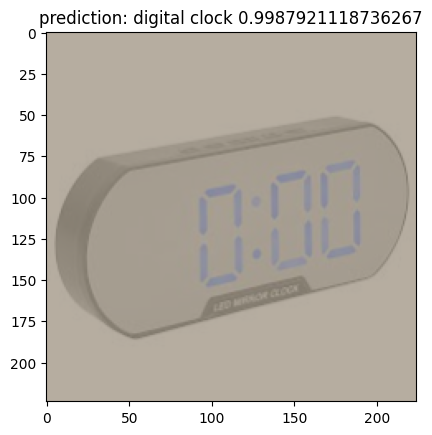

Image after Pixel Dropout
Minimum Pixels Dropped: 10


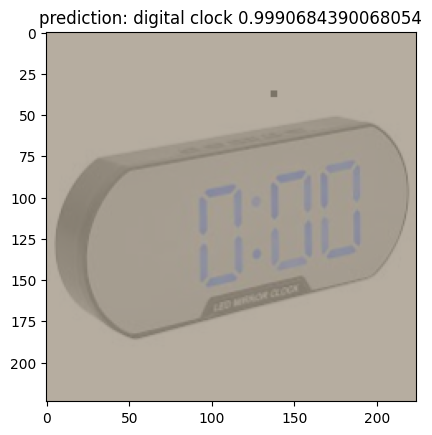

Image after FGSM: 


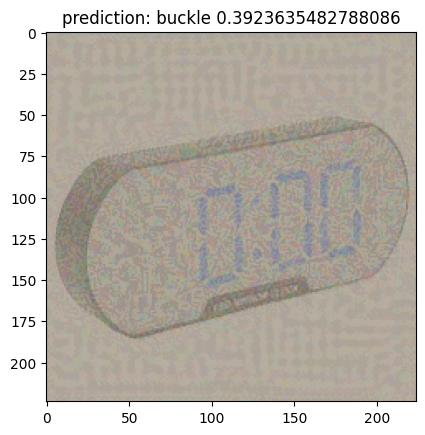

Image after Random Noise: 


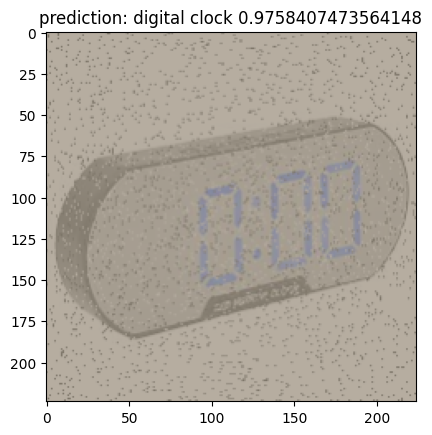

Image after Random Brightness: 


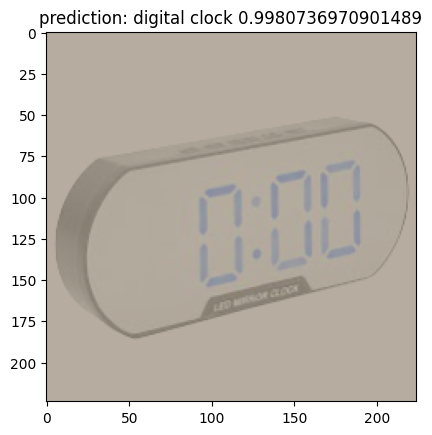

original image: 


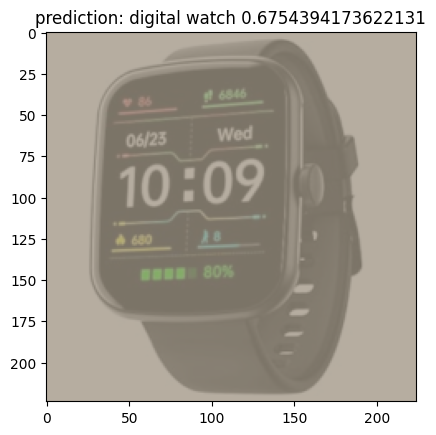

Image after Pixel Dropout
Minimum Pixels Dropped: 10


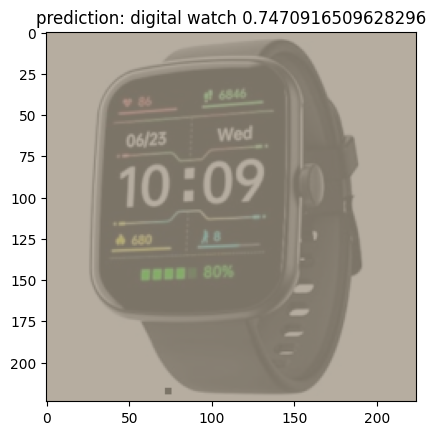

Image after FGSM: 


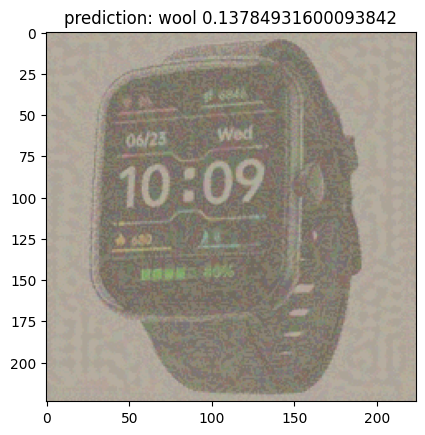

Image after Random Noise: 


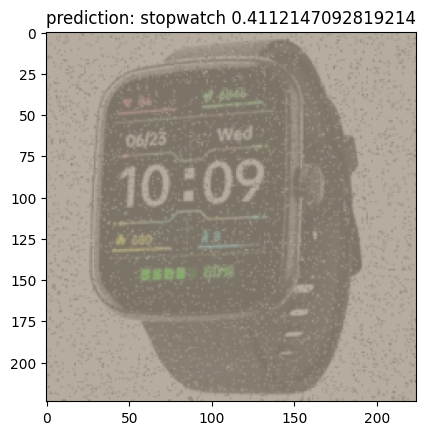

Image after Random Brightness: 


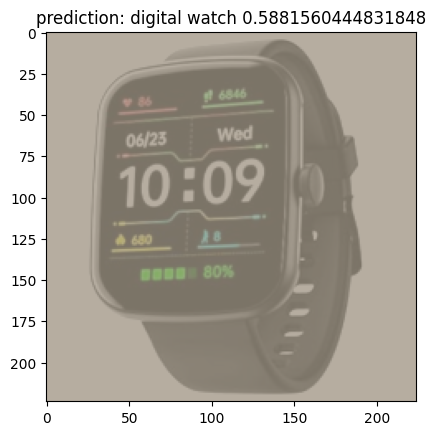

original image: 


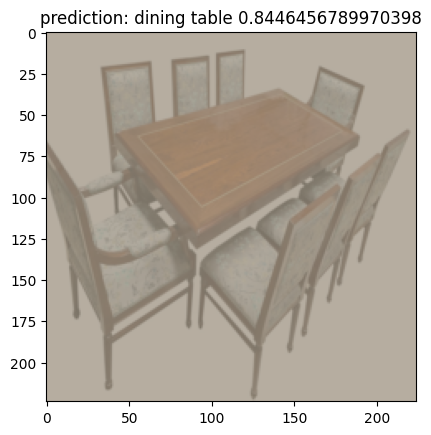

Image after Pixel Dropout
Minimum Pixels Dropped: 10


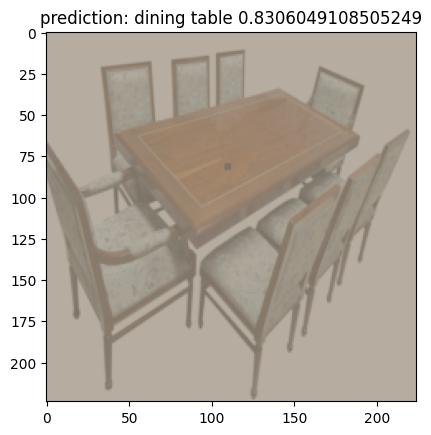

Image after FGSM: 


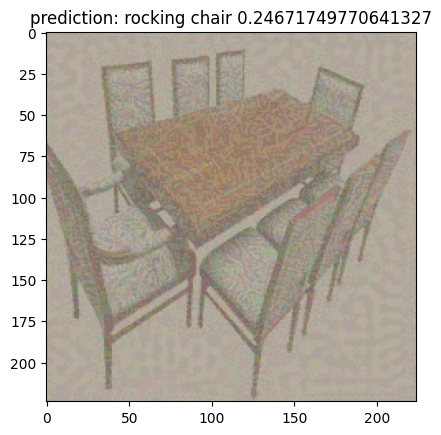

Image after Random Noise: 


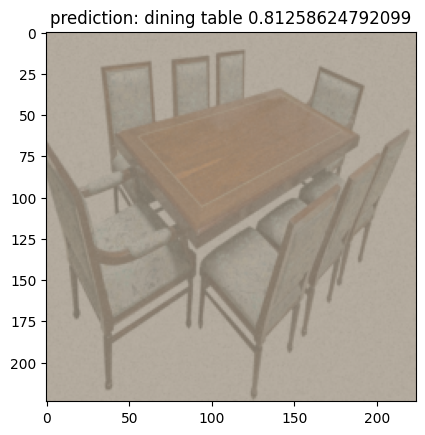

Image after Random Brightness: 


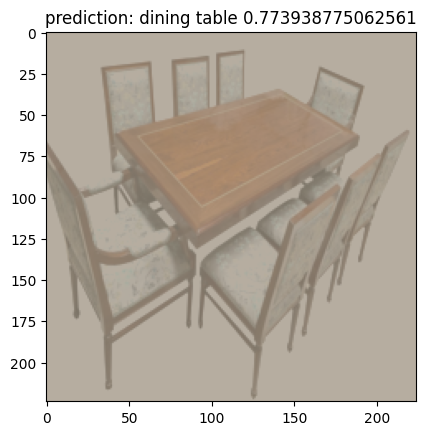

original image: 


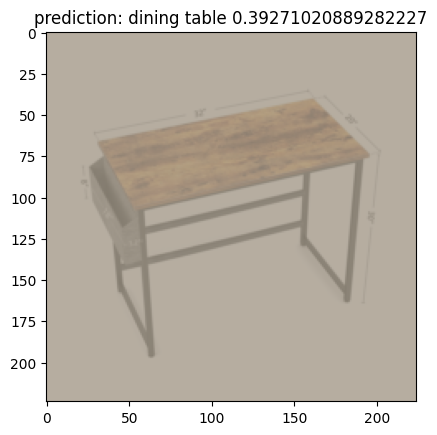

Image after Pixel Dropout
Minimum Pixels Dropped: 10


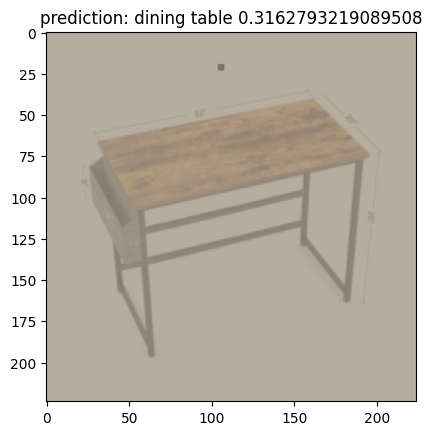

Image after FGSM: 


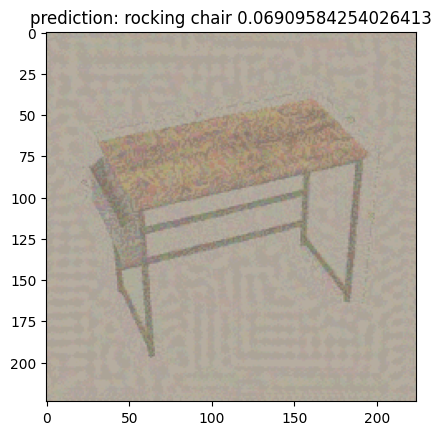

Image after Random Noise: 


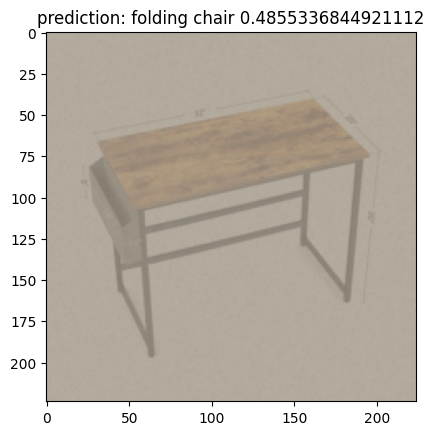

Image after Random Brightness: 


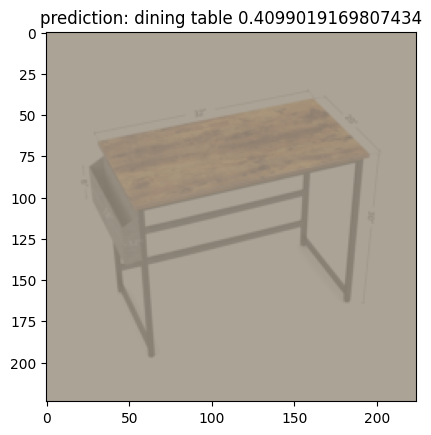

original image: 


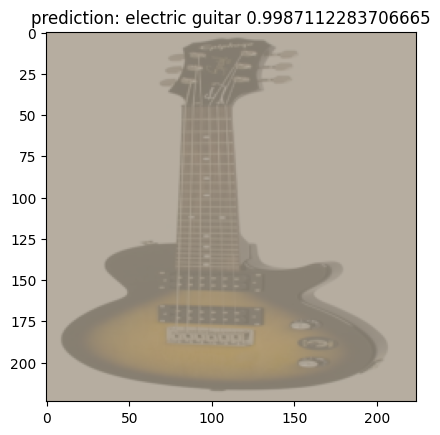

Image after Pixel Dropout
Minimum Pixels Dropped: 10


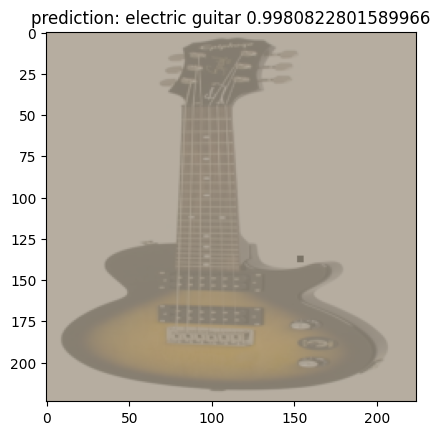

Image after FGSM: 


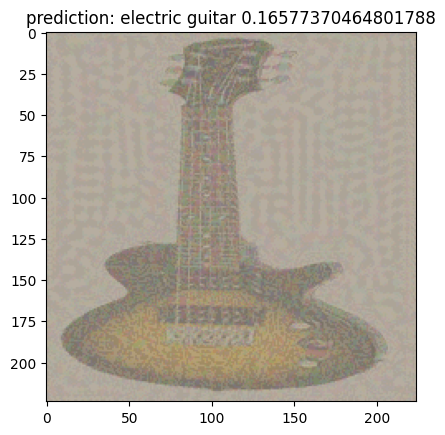

Image after Random Noise: 


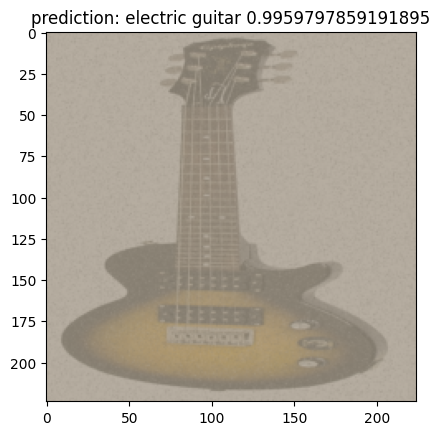

Image after Random Brightness: 


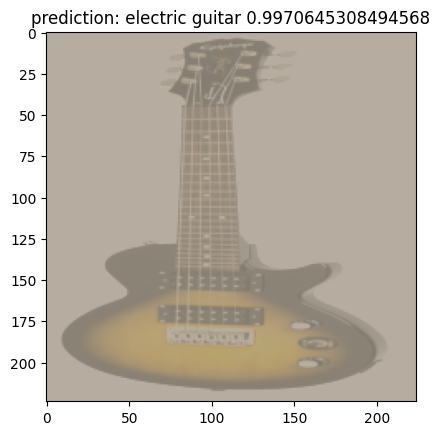

original image: 


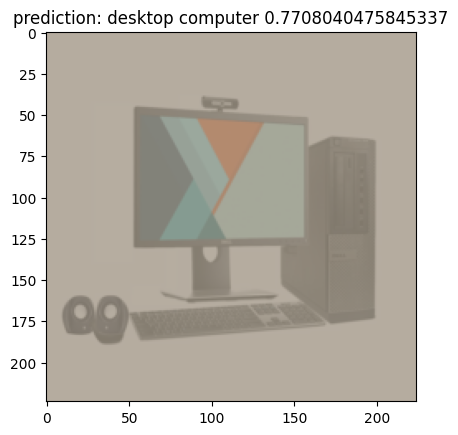

Image after Pixel Dropout
Minimum Pixels Dropped: 10


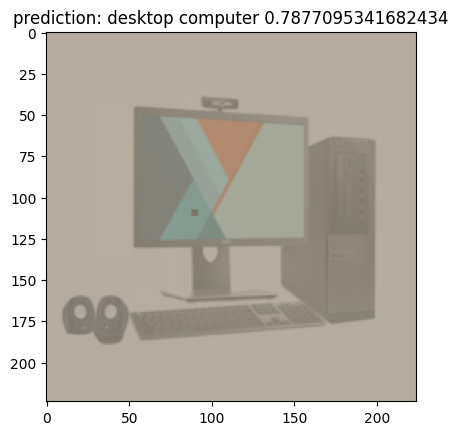

Image after FGSM: 


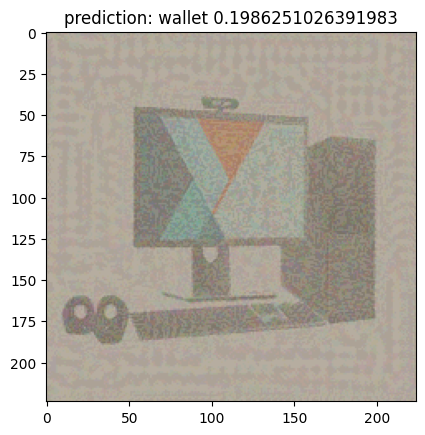

Image after Random Noise: 


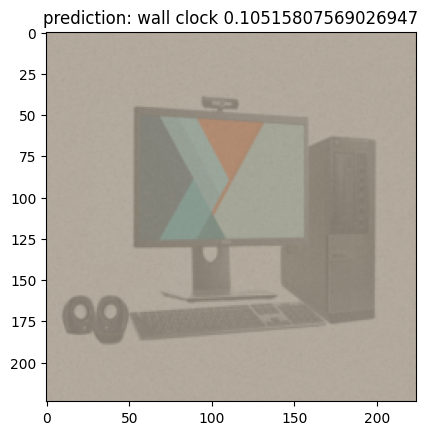

Image after Random Brightness: 


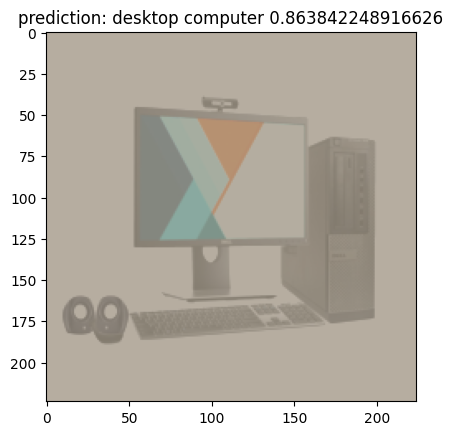

original image: 


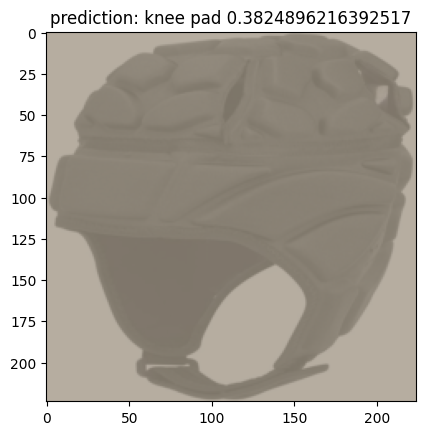

Image after Pixel Dropout
Minimum Pixels Dropped: 10


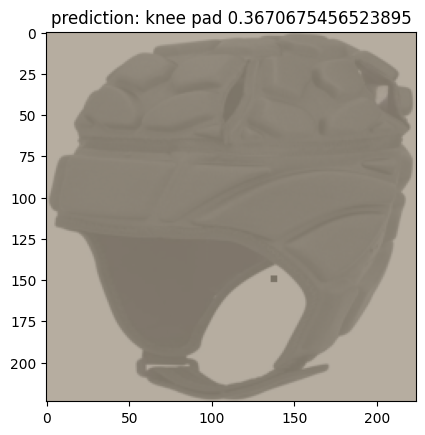

Image after FGSM: 


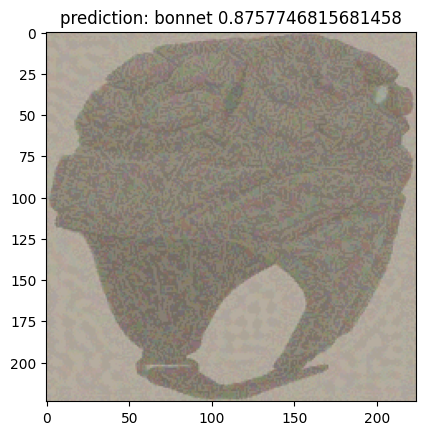

Image after Random Noise: 


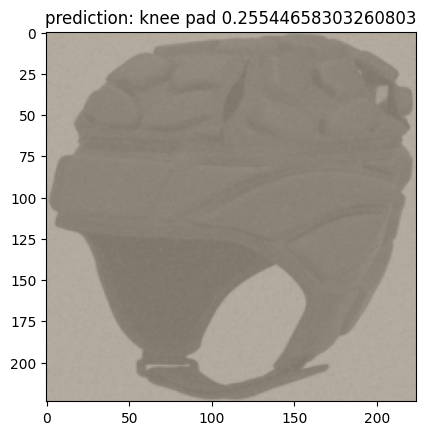

Image after Random Brightness: 


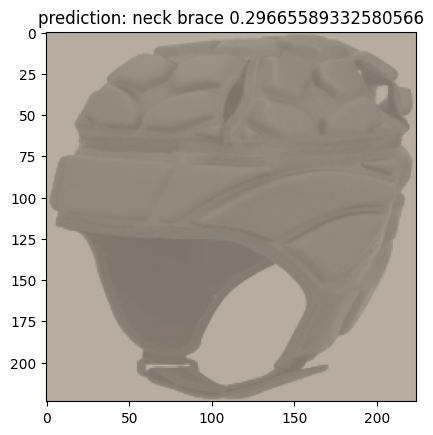

original image: 


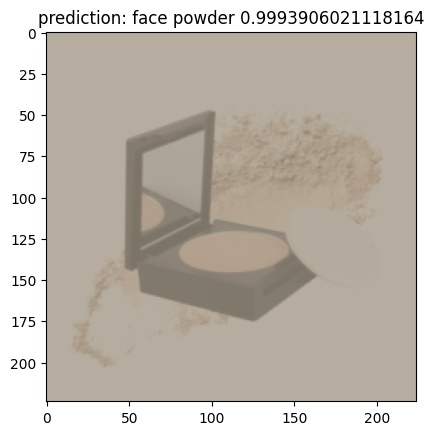

Image after Pixel Dropout
Minimum Pixels Dropped: 10


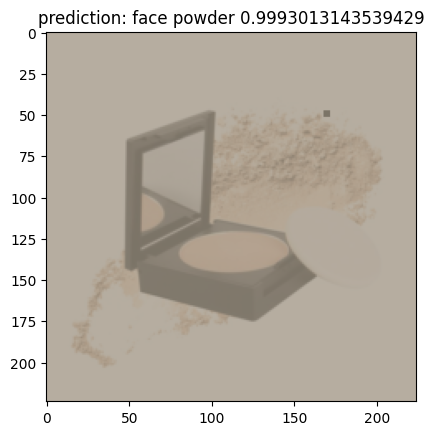

Image after FGSM: 


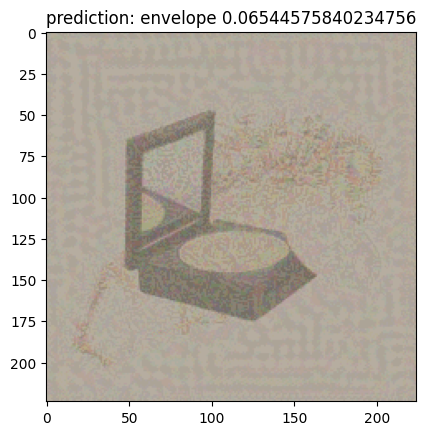

Image after Random Noise: 


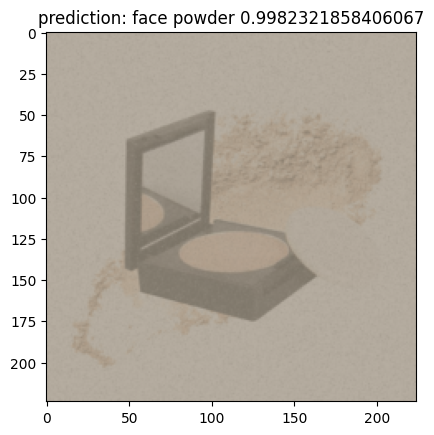

Image after Random Brightness: 


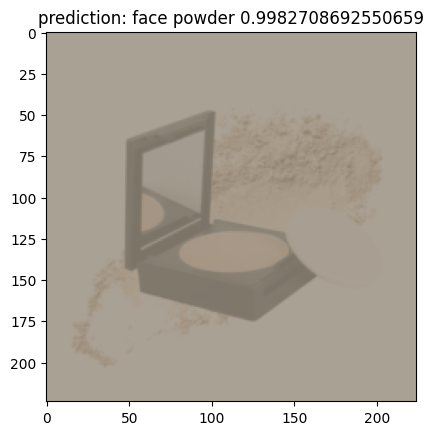

original image: 


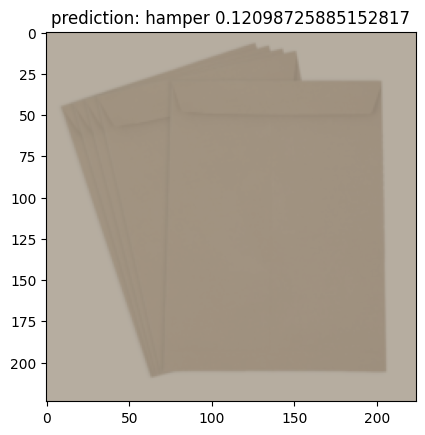

Image after Pixel Dropout
Minimum Pixels Dropped: 10


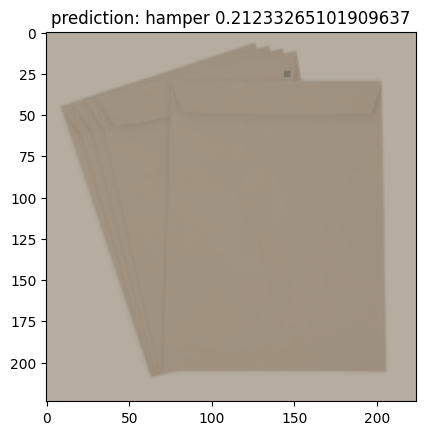

Image after FGSM: 


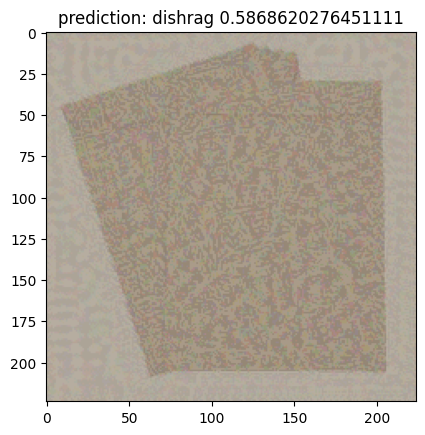

Image after Random Noise: 


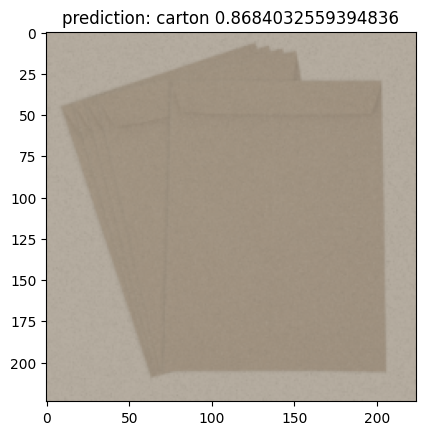

Image after Random Brightness: 


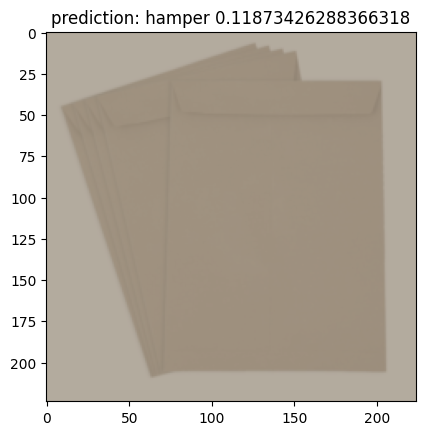

original image: 


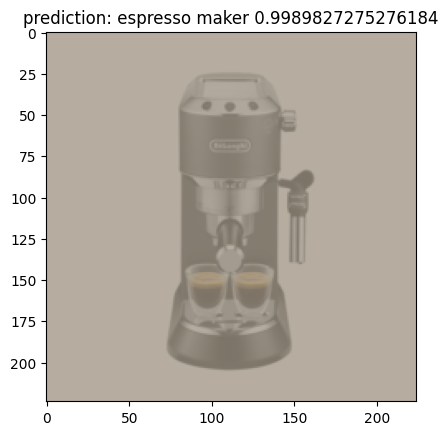

Image after Pixel Dropout
Minimum Pixels Dropped: 10


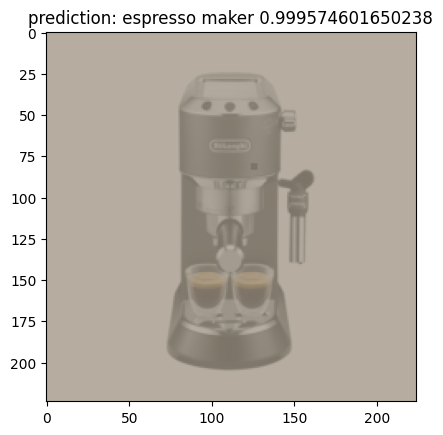

Image after FGSM: 


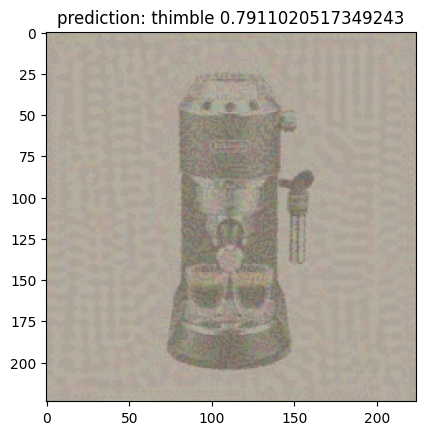

Image after Random Noise: 


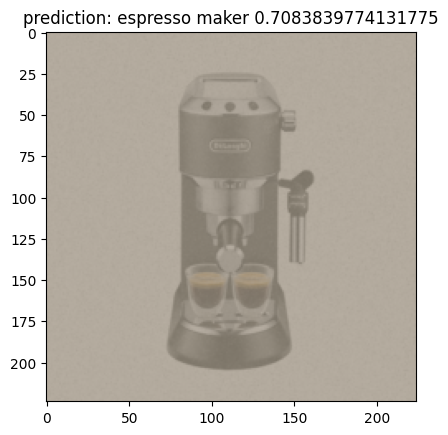

Image after Random Brightness: 


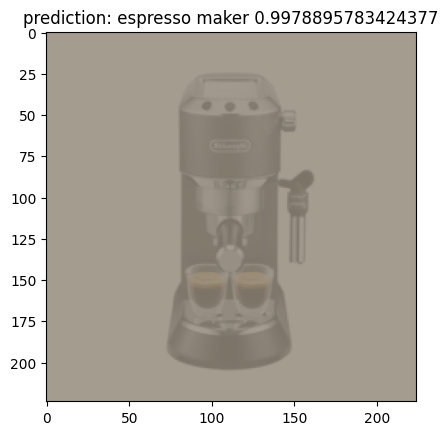

In [12]:
#handling robustness :
import urllib
import os
# import gradio as gr
import torch
import timm
import numpy as np

from PIL import Image
import random
import torchvision.transforms as T
import torch.nn.functional as F
from matplotlib.colors import LinearSegmentedColormap

from typing import Dict

from captum.attr import visualization as viz

#imports specifically for gradcam:
import matplotlib.pyplot as plt
from captum.robust import FGSM
from captum.robust import MinParamPerturbation

from captum.attr import FeatureAblation

from PIL import ImageEnhance

def random_brightness(image_tensor):
    # Convert tensor to PIL image
    image_pil = T.ToPILImage()(image_tensor.squeeze().cpu())

    # Apply random brightness
    enhancer = ImageEnhance.Brightness(image_pil)
    factor = np.random.uniform(0.5, 1.5)  # Random brightness factor
    img_bright = enhancer.enhance(factor)

    # Convert back to tensor
    bright_img_tensor = transform(img_bright).unsqueeze(0).to(device)
    return bright_img_tensor


device = torch.device("cuda:0")

transform = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
    T.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

def get_prediction(model, image: torch.Tensor):
    model = model.to(device)
    img_tensor = image.to(device)
    with torch.no_grad():
        output = model(img_tensor)
    output = F.softmax(output, dim=1)
    prediction_score, pred_label_idx = torch.topk(output, 1)

    pred_label_idx.squeeze_()
    predicted_label = categories[pred_label_idx.item()]

    return predicted_label, prediction_score.squeeze().item()

    # print('Predicted:', predicted_label, '(', prediction_score.squeeze().item(), ')')

def image_show(img, pred):
    npimg = inv_transform(img).squeeze().permute(1, 2, 0).detach().numpy()
    plt.imshow(npimg)
    plt.title("prediction: %s" % pred)
    plt.show()


#actual prediction starting here:
MODEL: str = "resnet18"

model = timm.create_model(MODEL, pretrained=True)
model.eval()
url, filename = (
    "https://raw.githubusercontent.com/pytorch/hub/master/imagenet_classes.txt",
    "imagenet_classes.txt",
)
urllib.request.urlretrieve(url, filename)
with open("imagenet_classes.txt", "r") as f:
    categories = [s.strip() for s in f.readlines()]

transform = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor()
])

transform_normalize = T.Normalize(
     mean=[0.485, 0.456, 0.406],
     std=[0.229, 0.224, 0.225]
)

def pixel_dropout(image, dropout_pixels):
    # keep_pixels = image[0][0].numel() - int(dropout_pixels)
    # vals, _ = torch.kthvalue(pixel_attr.flatten(), keep_pixels)
    # return (pixel_attr < vals.item()) * image
    # Ensure that 'pixel_attr' is on the same device as 'image'
    pixel_attr_device = pixel_attr.to(image.device)
    keep_pixels = image[0][0].numel() - int(dropout_pixels)
    vals, _ = torch.kthvalue(pixel_attr_device.flatten(), keep_pixels)
    return (pixel_attr_device < vals.item()) * image

# def sp_noise(image, prob): #for ranodm noise: using salt and pepper noise
    # image = image.cpu().numpy()
    # output = np.zeros(image.shape, np.uint8)
    # thres = 1 - prob
    # for i in range(image.shape[0]):
    #     for j in range(image.shape[1]):
    #         rdn = random.random()
    #         if rdn < prob:
    #             output[i][j] = 0
    #         elif rdn > thres:
    #             output[i][j] = 255
    #         else:
    #             output[i][j] = image[i][j]
    # return output


def sp_noise(image, prob):
    # Convert PIL Image to NumPy array
    image = np.array(image)
    output = np.zeros(image.shape, np.uint8)
    thres = 1 - prob
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            rdn = random.random()
            if rdn < prob:
                output[i][j] = 0
            elif rdn > thres:
                output[i][j] = 255
            else:
                output[i][j] = image[i][j]
    return Image.fromarray(output)


feature_mask = torch.arange(64 *7*7).reshape(8*7, 8*7).repeat_interleave(repeats=4, dim=1).repeat_interleave(repeats=4, dim=0).reshape(1, 1, 224,224)
feature_mask = feature_mask.to(device)
# print(feature_mask)
images =  os.listdir("/content/drive/MyDrive/img_dir/")
for image in images:
    img =  Image.open('/content/drive/MyDrive/img_dir/' + image)
    img_tensor = transform(img)
    img_tensor = img_tensor.unsqueeze(0)
    img_tensor.requires_grad = True
    img_tensor = img_tensor.to(device)

    mean = [0.485, 0.456, 0.406]
    std  = [0.229, 0.224, 0.225]
    inv_transform= T.Compose([
        T.Normalize(
            mean = (-1 * np.array(mean) / np.array(std)).tolist(),
            std = (1 / np.array(std)).tolist()
        ),
    ])
    print('original image: ')
    pred, score  = get_prediction(model, img_tensor)
    image_show(img_tensor.cpu(), pred + " " + str(score))

    print('Image after Pixel Dropout')
    ablator = FeatureAblation(model)
    attr = ablator.attribute(img_tensor, target=285, feature_mask=feature_mask)
    # Choose single channel, all channels have same attribution scores
    pixel_attr = attr[:,0:1]
    # min_pert_attr = MinParamPerturbation(forward_func=model, attack=pixel_dropout, arg_name="dropout_pixels", mode="linear",
    #                                     arg_min=0, arg_max=1024, arg_step=16,
    #                                     preproc_fn=None, apply_before_preproc=True)
    min_pert_attr = MinParamPerturbation(forward_func=model, attack=pixel_dropout, arg_name="dropout_pixels", mode="linear",
                                     arg_min=10, arg_max=1024, arg_step=10,
                                     preproc_fn=None, apply_before_preproc=True)

    pixel_dropout_im, pixels_dropped = min_pert_attr.evaluate(img_tensor, target=285, perturbations_per_eval=10)
    print("Minimum Pixels Dropped:", pixels_dropped)
    new_pred_dropout, score_dropout = get_prediction(model, pixel_dropout_im)
    image_show(pixel_dropout_im.cpu(), new_pred_dropout + " " + str(score_dropout))

    print('Image after FGSM: ')
    fgsm = FGSM(model, lower_bound=-1, upper_bound=1)
    perturbed_image_fgsm = fgsm.perturb(img_tensor, epsilon=0.16, target=285)
    new_pred_fgsm, score_fgsm = get_prediction(model, perturbed_image_fgsm)
    image_show(perturbed_image_fgsm.cpu(), new_pred_fgsm + " " + str(score_fgsm))

    # print('Image after Random Noise: ')
    # noise_img = sp_noise(img, 0.05)
    # prediction, score = get_prediction(model, noise_img)
    # image_show(noise_img,prediction + " " + str(score))
    print('Image after Random Noise: ')
    noise_img = sp_noise(img, 0.05)
    noise_img_tensor = transform(noise_img) # Assuming 'transform' is defined to convert PIL images to tensors
    noise_img_tensor = noise_img_tensor.unsqueeze(0).to(device)
    prediction, score = get_prediction(model, noise_img_tensor)
    image_show(noise_img_tensor.cpu(), prediction + " " + str(score))

    print("Image after Random Brightness: ")
    bright_img_tensor = random_brightness(img_tensor)
    bright_pred, bright_score = get_prediction(model, bright_img_tensor)
    image_show(bright_img_tensor.cpu(), bright_pred + " " + str(bright_score))
